# Intro

In [1]:
# Classic python
import pandas as pd
import numpy as np
from copy import deepcopy
import os
import sys
from importlib import reload
from scipy.stats import zscore
import scipy.io
import scipy
import textwrap
from scipy import sparse
import importlib
from itertools import product
import pickle  # saving outputs

# Plotting
import matplotlib
import matplotlib.pyplot as plt
# from matplotlib_venn import venn3, venn3_circles
import seaborn as sns
plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.figsize'] = 7, 3

# bioinformatics
import gget

# Controls/filtering
import control as ct
from control.matlab import *
# !pip install filterpy
from filterpy.kalman import KalmanFilter
from filterpy.common import Q_discrete_white_noise

# working with MATLAB
import mat73

# local imports
sys.path.append("../python/")

import nb_util as nb
reload(nb)

import utils as ut
reload(ut)

import hasnain_DMD
reload(hasnain_DMD)

import sensorSelection
reload(sensorSelection)

# globals
# outPath = '~/DMD_gene/notebooks/figures/'
outPath = '/scratch/indikar_root/indikar0/jpic/obsvFigures/'
curPath = !pwd
curPath = curPath[0]
rerun = False

In [2]:
def getC(n, idxs):
    C = np.zeros((len(idxs), n))
    for i in range(len(idxs)):
        C[i, int(idxs[i])] = 1
    return C

def wrap_ylabels(ax, width):
    labels = []
    for label in ax.get_yticklabels():
        text = label.get_text()
        labels.append(textwrap.fill(text, width=width,
                      break_long_words=False))
    ax.set_yticklabels(labels, rotation=0)
    
# filter out uninteresting genes
def filterGeneSet(tpm_2015, tpm_2018, k=1000, criteria='entropy', mergeGeneSets=True):
    if criteria == 'entropy':
        tpm_2015_normalized = tpm_2015.div(tpm_2015.sum(axis=1), axis=0)
        tpm_2018_normalized = tpm_2018.div(tpm_2018.sum(axis=1), axis=0)
        tpm_score_2015 = -(tpm_2015_normalized * np.log(tpm_2015_normalized)).sum(axis=1)
        tpm_score_2018 = -(tpm_2018_normalized * np.log(tpm_2018_normalized)).sum(axis=1)
    elif criteria == 'avg':
        tpm_score_2015 = tpm_2015.mean(axis=1)
        tpm_score_2018 = tpm_2018.mean(axis=1)
    elif criteria == 'std':
        tpm_score_2015 = tpm_2015.std(axis=1)
        tpm_score_2018 = tpm_2018.std(axis=1)

    # select k largest indices
    top_k_indices_2015 = tpm_score_2015.nlargest(k).index
    top_k_indices_2018 = tpm_score_2018.nlargest(k).index

    if mergeGeneSets:
        # take union of genes selected from 2015 and 2018
        include_indices = (top_k_indices_2015).union(top_k_indices_2018)

        # remove genes not aparent in both 2015 and 2018
        common_indices = set(tpm_2015.index) & set(tpm_2018.index)
        include_indices = include_indices.intersection(common_indices)

        # recude the data to have the same indices
        tpm_r_2015 = tpm_2015[tpm_2015.index.isin(include_indices)]
        tpm_r_2018 = tpm_2018[tpm_2015.index.isin(include_indices)]
        gene_list = include_indices
    else:
        tpm_r_2015 = tpm_2015[tpm_2015.index.isin(top_k_indices_2015)]
        tpm_r_2018 = tpm_2018[tpm_2018.index.isin(top_k_indices_2018)]
        gene_list = (top_k_indices_2015, top_k_indices_2018)

    # convert to DMD format
    dmd_data_2015 = nb.data2DMD(tpm_r_2015, rescale=False)
    dmd_data_2018 = nb.data2DMD2017(tpm_r_2018, rescale=False)

    return dmd_data_2015, dmd_data_2018, gene_list

def fnameArgs(dict):
    filename = ''
    for i in dict.keys():
        filename += '_' + str(i) + str(dict[i])
    return filename

def generate_combinations(*lists):
    return product(*lists)

def obsv(a, c, t=None):
    """
    Compute the observability matrix.

    Parameters:
    - a: State matrix
    - c: Output matrix

    Returns:
    - ob: Observability matrix [c; ca; ca^2; ...]
    """
    # Dimension checking
    n = a.shape[0]
    ny = c.shape[0]
    if not (n == a.shape[1] == c.shape[1]):
        raise ValueError("Input dimensions are not compatible")

    if t is None:
        t = n
        
    # Allocate ob and compute each C A^k term
    ob = np.zeros((t * ny, n))
    ob[:ny, :] = c
        
    for k in range(1, t):
        ob[k * ny:(k + 1) * ny, :] = np.dot(ob[(k - 1) * ny:k * ny, :], a)

    return ob

In [3]:
# 2015 data
data_path_2015 = f"/nfs/turbo/umms-indikar/shared/projects/cell_cycle/data/RNA_pipeline_ouputs/countMatrix/counts.raw.txt"
gene_path_2015 = f"/nfs/turbo/umms-indikar/shared/projects/cell_cycle/data/RNA_pipeline_ouputs/references/geneTable.csv"

# 2018 data
data_path_2018 = f"/nfs/turbo/umms-indikar/shared/projects/myod/data/rnaseq/2018_rna/countMatrix/counts.raw.txt"
gene_path_2018 = f"/nfs/turbo/umms-indikar/shared/projects/myod/data/rnaseq/2018_rna/references/geneTable.csv"

# Load the raw expression
df_2015 = pd.read_csv(data_path_2015, index_col=0)
df_2018 = pd.read_csv(data_path_2018, index_col=0)

# remove MT and ribosomal genes
all_genes_2015 = df_2015.index.to_list()
all_genes_2018 = df_2018.index.to_list()
mt_genes_2015 = [x for x in all_genes_2015 if x.startswith('MT-')]
rp_genes_2015 = [x for x in all_genes_2015 if x.startswith('RP')]
mt_genes_2018 = [x for x in all_genes_2018 if x.startswith('MT-')]
rp_genes_2018 = [x for x in all_genes_2018 if x.startswith('RP')]
df_2015 = df_2015.drop(mt_genes_2015) # drop MT genes
df_2015 = df_2015.drop(rp_genes_2015) # drop ribosomal genes
df_2018 = df_2018.drop(mt_genes_2018) # drop MT genes
df_2018 = df_2018.drop(rp_genes_2018) # drop ribosomal genes

# rewrite the list for removed genes
gene_names_2015 = df_2015.index.to_list()
gene_names_2018 = df_2018.index.to_list()

# Load gene lengths
gf_2015 = nb.getGeneLengths(gene_path_2015, gene_names_2015)
gf_2018 = nb.getGeneLengths(gene_path_2018, gene_names_2018)

# Convert to TPM
tpm_2015 = nb.TPM(df_2015, gf_2015)
tpm_2018 = nb.TPM(df_2018, gf_2018)

print(tpm_2015.shape)
print(tpm_2018.shape)

/home/jpic/DMD_gene/notebooks/nb_util.py:113: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  gf = pd.read_csv(gene_table_path)
/home/jpic/DMD_gene/notebooks/nb_util.py:113: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  gf = pd.read_csv(gene_table_path)


(19235, 18)
(19235, 48)


# Sensor Selection Methods

## Stability of Gram Matrix

How do the top ranked genes vary as the finite horizon Gram matrix has its summation bounds increase?

* for each data set 
* for 3 gene selection criteria
* for many values in the Gram matrix summation
* rank the genes as sensors according to the Gram matrix weights

visualize how the rankings change as the Gram computation varies

`TODO:`
Change color map to be continuous rather than discrete

New: Plot first difference of gene ranks over time (done, although not very pretty)

In [3]:
selectionCriteria = ['entropy', 'avg', 'std']
gram_horizons = [1,2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400]
nGenes = 1000

In [7]:
# DON'T NEED TO RERUN, RESULTS HAVE BEEN SAVED TO A FILE
if rerun:
    for criteria in selectionCriteria:
        print(criteria)
        dmd_data_2015, dmd_data_2018, gene_list = filterGeneSet(tpm_2015, tpm_2018, k=nGenes, criteria=criteria)
        ss2015, ss2018 = {'dmd': None}, {'dmd': None}
        for gramT in gram_horizons:
            print('    ' + str(gramT), end=',')
            ss2015 = sensorSelection.hasnain2023(dmd_data_2015, dmd_rank=7, gramT=gramT, vxNames=gene_list, dmd_res=ss2015['dmd'])   
            ss2015['sensors'].to_csv(outPath + 'gramStability/2015_' + criteria + '_' + str(nGenes) + '_gramT_' + str(gramT) + '.csv')
            ss2018 = sensorSelection.hasnain2023(dmd_data_2015, dmd_rank=7, gramT=gramT, vxNames=gene_list, dmd_res=ss2018['dmd'])   
            ss2018['sensors'].to_csv(outPath + 'gramStability/2018_' + criteria + '_' + str(nGenes) + '_gramT_' + str(gramT) + '.csv')
        print('')

In [8]:
geneRankings = {}
for criteria in selectionCriteria:
    for ds in ['2015', '2018']:
        dfW, dfR = pd.DataFrame(), pd.DataFrame()
        for gramT in gram_horizons:
            df = pd.read_csv(outPath + 'gramStability/' + ds + '_' + criteria + '_' + str(nGenes) + '_gramT_' + str(gramT) + '.csv')
            df = df.set_index('gene')
            dfW['Itr: ' + str(gramT)] = df['weight']
            dfR['Itr: ' + str(gramT)] = df['rank']
        geneRankings[criteria + '_' + ds] = {'W': dfW,
                                             'R': dfR}

### First Differences in Sensor Ranks

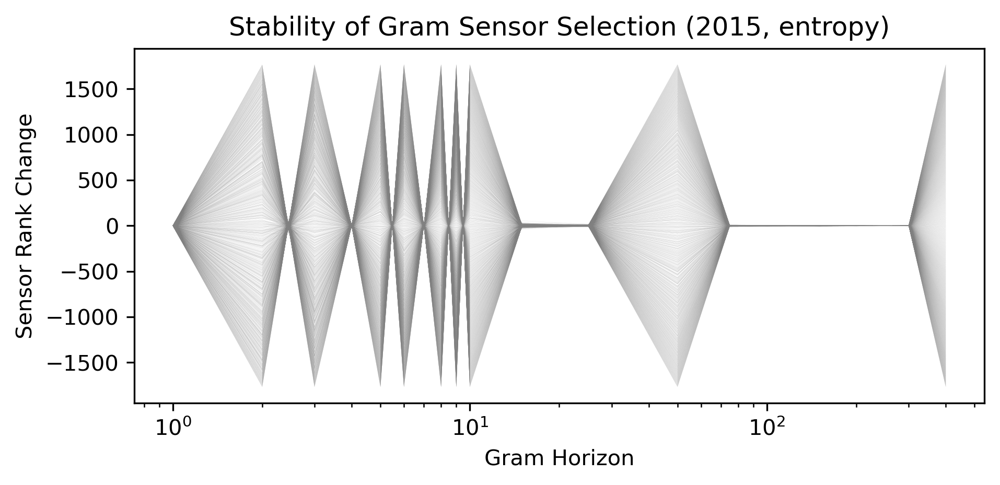

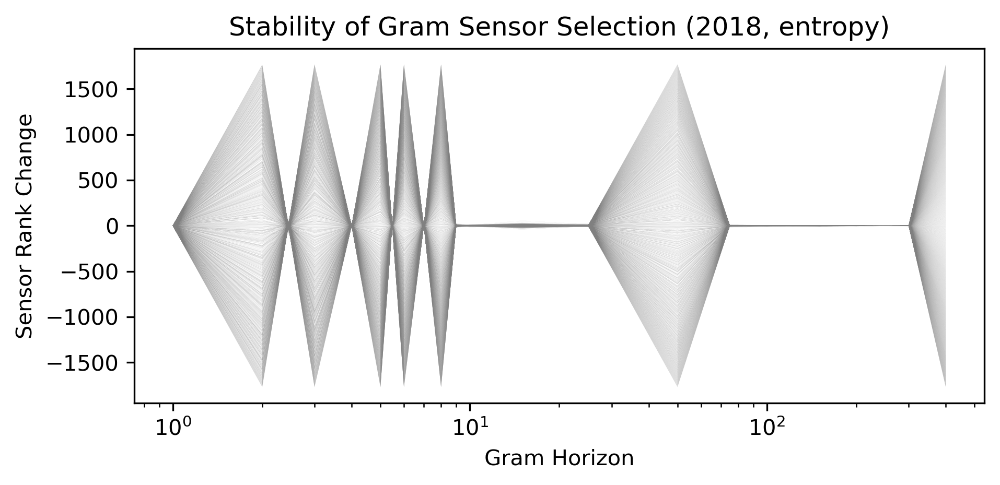

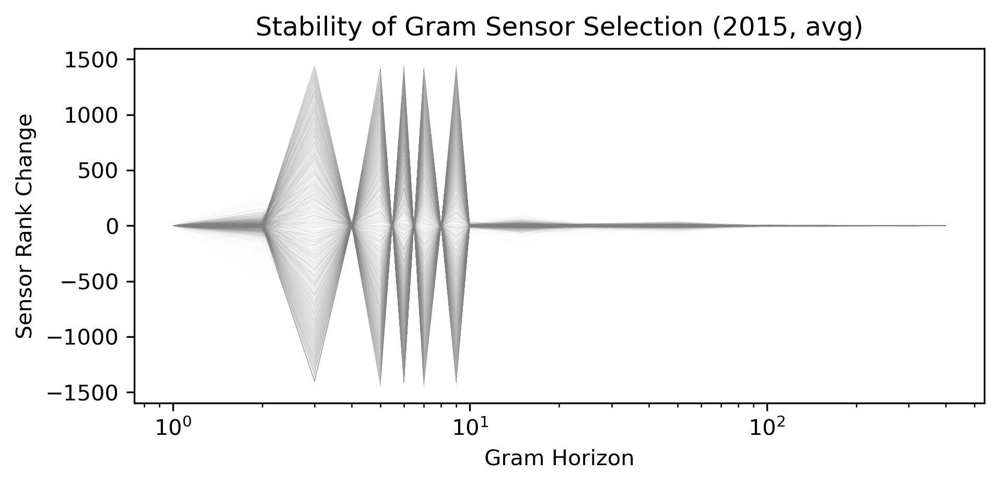

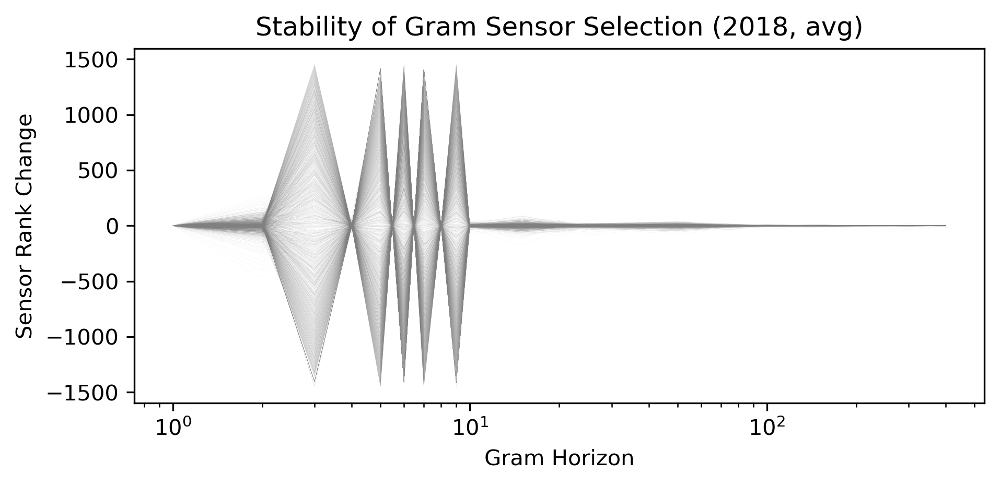

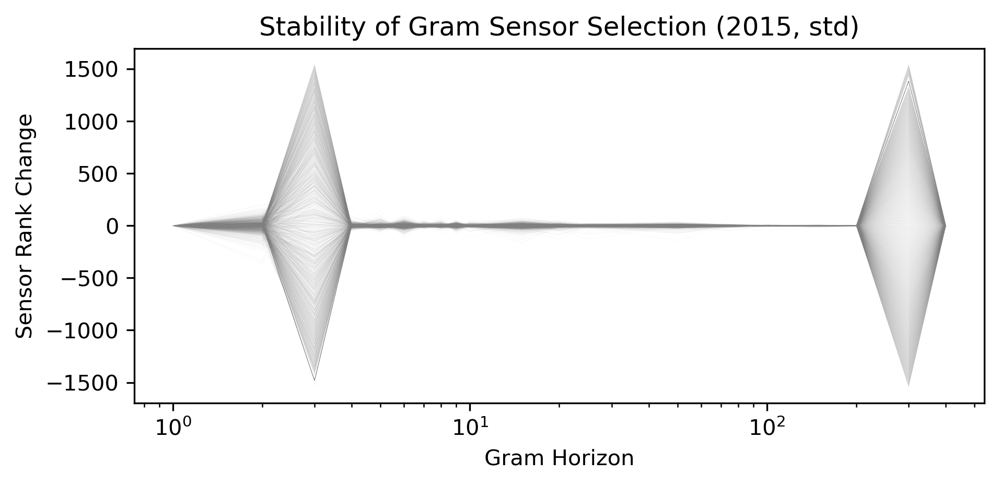

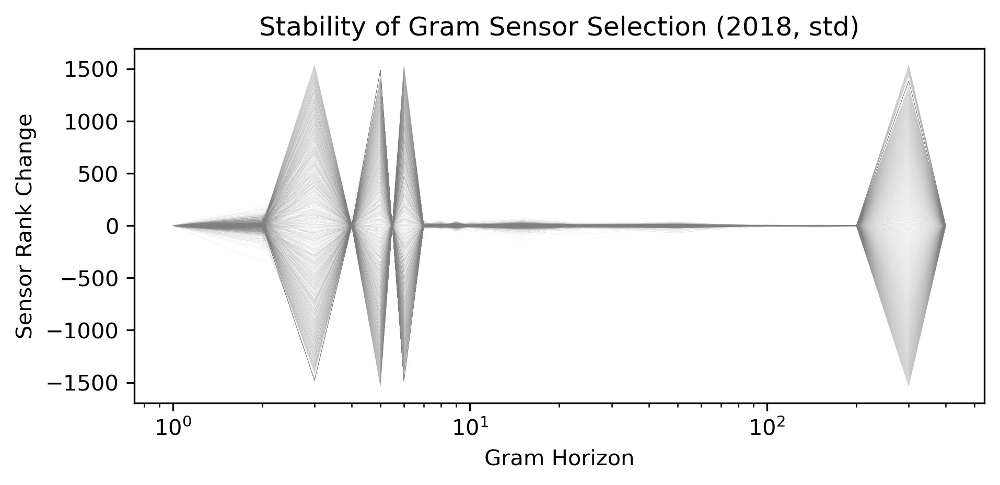

In [9]:
for criteria in selectionCriteria:
    for ds in ['2015', '2018']:
        dfR = geneRankings[criteria + '_' + ds]['R']
        df_differences = pd.DataFrame()
        for i in range(len(dfR.columns) - 1):
            df_differences[i] = dfR.iloc[:, i] - dfR.iloc[:, i + 1]
        xrange = np.arange(df_differences.shape[1])
        for i in range(df_differences.shape[0]):
            y = df_differences.iloc[i,:].values
            y = np.insert(y, 0, 0)
            # print(y)
            plt.plot(gram_horizons,y,'-', color='grey', linewidth=0.01)

        # Add labels and title
        plt.xlabel('Gram Horizon')
        plt.xscale('log')
        plt.ylabel('Sensor Rank Change')
        plt.title('Stability of Gram Sensor Selection (' + ds + ', ' + criteria + ')')

        # Show the plot
        plt.show()

### Bump Plot of top sensors

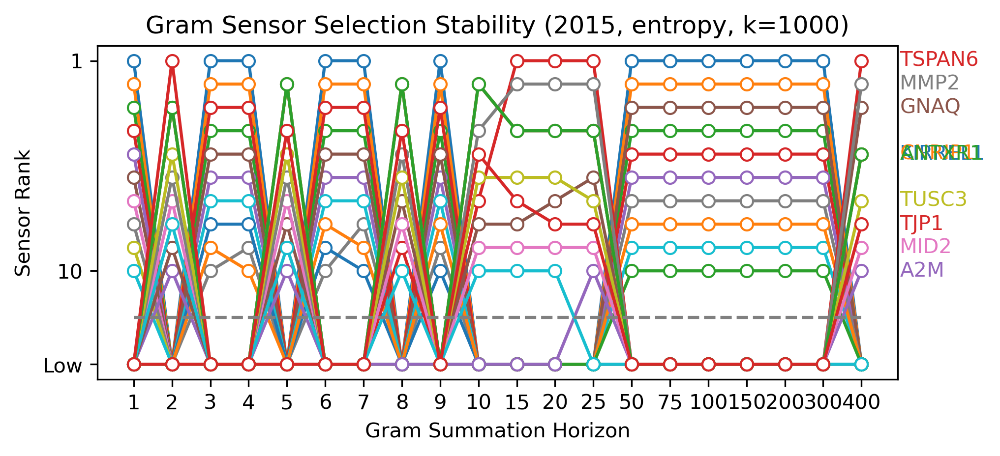

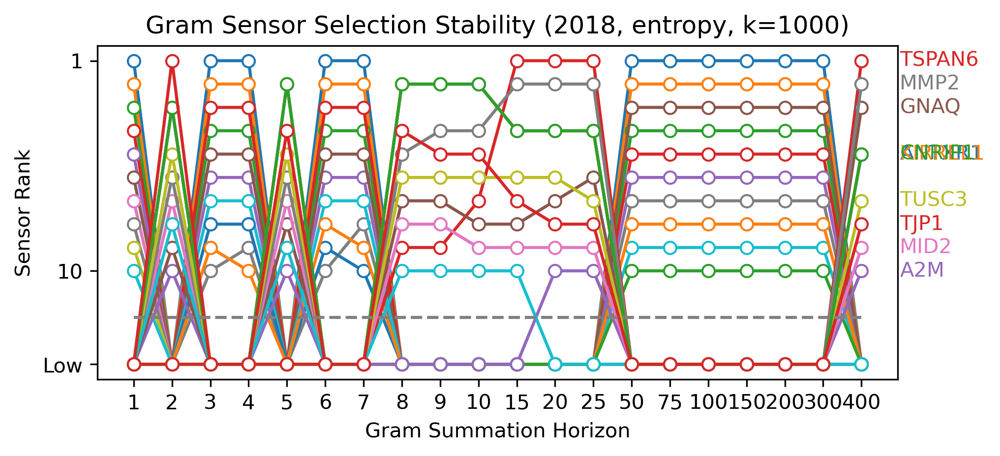

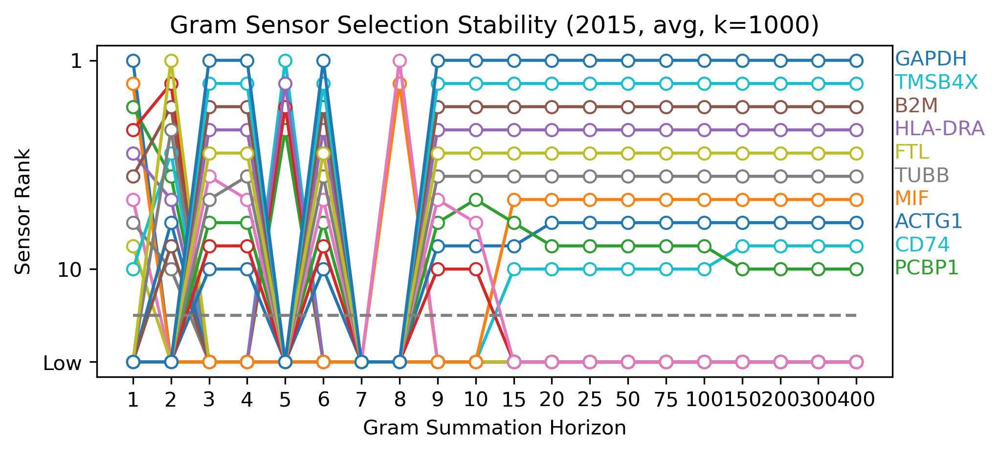

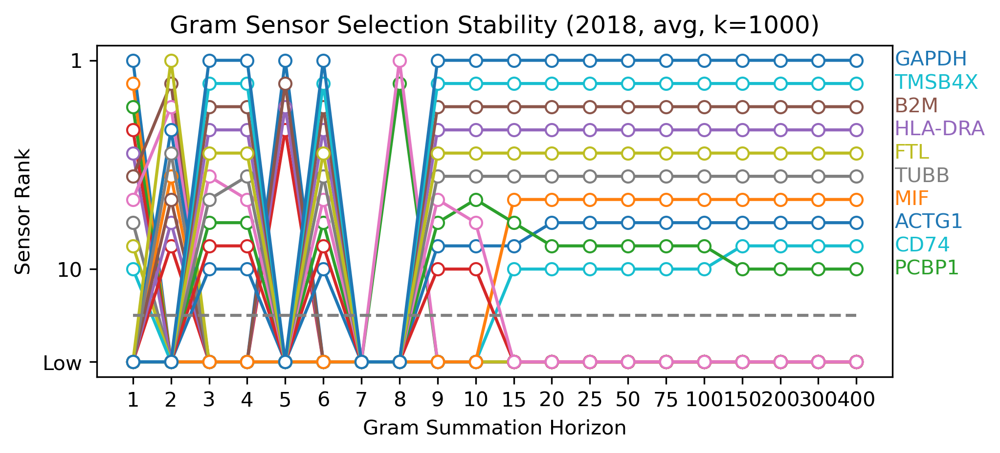

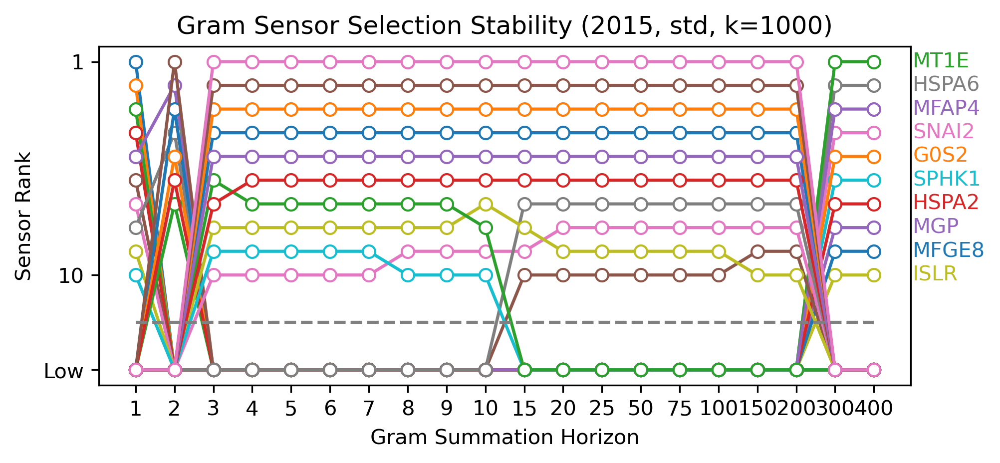

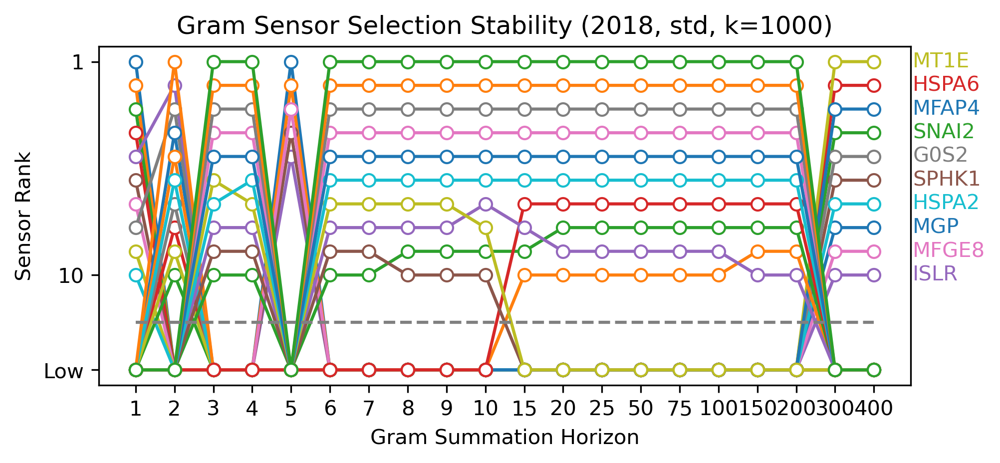

<Figure size 2100x900 with 0 Axes>

In [10]:
for criteria in selectionCriteria:
    for ds in ['2015', '2018']:
        df = geneRankings[criteria + '_' + ds]['R'][geneRankings[criteria + '_' + ds]['R'].min(axis=1) <= 10]
        xrange = np.arange(df.shape[1]) + 1
        for gene in df.index:
            ranks = df.loc[[gene]].values.reshape((len(xrange),))
            ranks[ranks > 10] = 14
            line, = plt.plot(xrange, ranks, '-o', markerfacecolor='white')
            if ranks[-1] <= 10:
                plt.text(xrange[-1] + 1, ranks[-1], gene, ha='left', va='center', color=line.get_color())

        plt.plot(xrange, 12 * np.ones((len(xrange),1)), '--', color='grey')
        
        plt.xticks(xrange, gram_horizons)
        plt.gca().invert_yaxis()
        plt.xlabel('Gram Summation Horizon')
        plt.ylabel('Sensor Rank')
        plt.title('Gram Sensor Selection Stability (' + ds + ', ' + criteria + ', k=1000)')
        tick_positions = [1, 10, 14]
        tick_labels = ['1', '10', 'Low']
        plt.yticks(tick_positions, tick_labels)
        # plt.xscale('log')
        plt.show()
        figName = 'gram_stability_' + ds + '_' + criteria + '.jpg'
        plt.savefig(outPath + figName)
        plt.savefig(curPath + '/figures/' + figName)


### Kalman Filtering at Different Gram Sizes

In [18]:
numSensors = list([1, 5, 10, 25, 50, 75, 100])

In [24]:
ds = ['2015'] #, '2018']
selectionCriteria = ['entropy', 'avg'] #, 'std']
gram_horizons = [1,2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400]
numSensors = list([1, 5, 10, 25, 50, 75, 100])
nGenes = 1000
nsims = 10
simArgs = {'year'    : None,
           'criteria': None,
           'nSensors': None,
           'nGenes'  : nGenes,
           'nsims'   : nsims
          }
out = {}

In [25]:
itr = generate_combinations(ds, selectionCriteria, numSensors)
for simArgs['year'], simArgs['criteria'], simArgs['nSensors'] in itr:
    print(simArgs)
    dmd_data_2015, dmd_data_2018, gene_list_separate = filterGeneSet(tpm_2015, tpm_2018, 
                                                        k=simArgs['nGenes'],
                                                        criteria=simArgs['criteria'],
                                                        mergeGeneSets=False)
    gene_list_separate = {'2015': gene_list_separate[0],
                          '2018': gene_list_separate[1]}
    trajectories = {'2015': dmd_data_2015,
                    '2018': dmd_data_2018}
    gene_list = gene_list_separate[simArgs['year']]
    trajectory = trajectories[simArgs['year']]
    
    estimatorSet = {}
    usedC = []
    for gramT in gram_horizons:
        ss = sensorSelection.hasnain2023(trajectory, dmd_rank=7, gramT=gramT, vxNames=gene_list)

        A = ss['dmd']['A']
        sensors = ss['sensors']
        sensorGenes = sensors['gene'].values[:simArgs['nSensors']]
        idxs = [list(gene_list).index(gene) for gene in sensorGenes]
        idxs.sort()
        print(idxs)
        C = getC(A.shape[0], idxs)
        
        isused = any(np.array_equal(C, arr) for arr in usedC)
        if isused:
            print('    Stable Sensors (KF skipped)')
            continue
        else:
            usedC.append(C)

        trajectoryUnfolded = trajectory.reshape([trajectory.shape[0], trajectory.shape[1]*2])
        Q = 1 * np.cov(trajectoryUnfolded)

        # construct Kalman filter
        f = KalmanFilter (dim_x=A.shape[0], dim_z=C.shape[0])
        f.F = A
        f.H = C
        f.Q = Q

        trajs = []
        print('    ', end='')
        for i in range(simArgs['nsims']):
            print(str(i), end=', ')
            f.x = 1 * np.random.rand(A.shape[0])
            Xhat = [f.x]
            for i in range(trajectory.shape[1]-1):
                f.predict()
                f.update(C @ trajectory[:,i,0])
                Xhat.append(f.x)
            trajectoriesHat = np.array(Xhat).T
            trajs.append(trajectoriesHat)
        print('')

        estimatorSet[gramT] = trajs
    out[simArgs['year'] + simArgs['criteria'] + str(simArgs['nSensors'])] = estimatorSet

{'year': '2015', 'criteria': 'entropy', 'nSensors': 1, 'nGenes': 1000, 'nsims': 10}


/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


[380]
    0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 
[753]
    0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 
[753]
    Stable Sensors (KF skipped)
[753]
    Stable Sensors (KF skipped)
[753]
    Stable Sensors (KF skipped)
[753]
    Stable Sensors (KF skipped)
[753]
    Stable Sensors (KF skipped)
[753]
    Stable Sensors (KF skipped)
[753]
    Stable Sensors (KF skipped)
[753]
    Stable Sensors (KF skipped)
[753]
    Stable Sensors (KF skipped)
[753]
    Stable Sensors (KF skipped)
[753]
    Stable Sensors (KF skipped)
[753]
    Stable Sensors (KF skipped)
[753]
    Stable Sensors (KF skipped)
[753]
    Stable Sensors (KF skipped)
[753]
    Stable Sensors (KF skipped)
[753]
    Stable Sensors (KF skipped)
[753]
    Stable Sensors (KF skipped)
[753]
    Stable Sensors (KF skipped)
{'year': '2015', 'criteria': 'entropy', 'nSensors': 5, 'nGenes': 1000, 'nsims': 10}


/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


[252, 254, 380, 576, 674]
    0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 
[313, 402, 753, 943, 987]
    0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 
[313, 402, 753, 943, 987]
    Stable Sensors (KF skipped)
[313, 402, 753, 943, 987]
    Stable Sensors (KF skipped)
[313, 402, 753, 943, 987]
    Stable Sensors (KF skipped)
[402, 438, 753, 943, 987]
    0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 
[402, 438, 753, 943, 987]
    Stable Sensors (KF skipped)
[402, 438, 753, 943, 987]
    Stable Sensors (KF skipped)
[402, 438, 753, 943, 987]
    Stable Sensors (KF skipped)
[402, 438, 753, 943, 987]
    Stable Sensors (KF skipped)
[402, 438, 753, 943, 987]
    Stable Sensors (KF skipped)
[402, 438, 753, 943, 987]
    Stable Sensors (KF skipped)
[402, 438, 753, 943, 987]
    Stable Sensors (KF skipped)
[402, 438, 753, 943, 987]
    Stable Sensors (KF skipped)
[402, 438, 753, 943, 987]
    Stable Sensors (KF skipped)
[402, 438, 753, 943, 987]
    Stable Sensors (KF skipped)
[402, 438, 753, 943, 987]
    Stable Sensors (KF skipped)
[402,

/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


[190, 252, 254, 352, 376, 380, 576, 618, 650, 674]
    0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 
[209, 313, 316, 393, 402, 438, 462, 753, 943, 987]
    0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 
[177, 209, 313, 316, 402, 438, 462, 753, 943, 987]
    0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 
[209, 313, 316, 393, 402, 438, 462, 753, 943, 987]
    Stable Sensors (KF skipped)
[18, 209, 313, 316, 402, 438, 462, 753, 943, 987]
    0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 
[18, 209, 313, 316, 402, 438, 462, 753, 943, 987]
    Stable Sensors (KF skipped)
[18, 209, 313, 316, 402, 438, 462, 753, 943, 987]
    Stable Sensors (KF skipped)
[18, 209, 313, 316, 402, 438, 462, 753, 943, 987]
    Stable Sensors (KF skipped)
[18, 209, 313, 316, 402, 438, 462, 753, 943, 987]
    Stable Sensors (KF skipped)
[18, 209, 313, 316, 402, 438, 462, 753, 943, 987]
    Stable Sensors (KF skipped)
[18, 209, 313, 316, 402, 438, 462, 753, 943, 987]
    Stable Sensors (KF skipped)
[18, 209, 313, 316, 402, 438, 462, 753, 943, 987]
    Stable Sensors (KF skipped)


/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


[48, 59, 190, 204, 252, 254, 352, 376, 380, 391, 399, 436, 502, 530, 532, 576, 605, 618, 620, 650, 651, 655, 674, 744, 899]
    0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 
[9, 18, 38, 75, 139, 144, 177, 209, 313, 316, 393, 402, 438, 462, 478, 705, 753, 784, 799, 821, 840, 943, 944, 949, 987]
    0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 
[9, 18, 38, 75, 139, 144, 177, 209, 313, 316, 393, 402, 438, 462, 478, 705, 753, 784, 799, 821, 840, 943, 944, 949, 987]
    Stable Sensors (KF skipped)
[9, 18, 38, 139, 144, 177, 209, 313, 316, 393, 402, 438, 462, 478, 705, 753, 769, 784, 799, 821, 840, 943, 944, 949, 987]
    0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 
[9, 18, 38, 139, 144, 177, 209, 313, 316, 393, 402, 438, 462, 478, 705, 753, 769, 784, 799, 821, 840, 943, 944, 949, 987]
    Stable Sensors (KF skipped)
[9, 18, 38, 139, 144, 177, 209, 313, 316, 393, 402, 438, 462, 478, 705, 753, 769, 784, 799, 821, 840, 943, 944, 949, 987]
    Stable Sensors (KF skipped)
[9, 18, 38, 139, 144, 177, 209, 313, 316, 393, 402, 438, 462, 478, 

/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


[20, 48, 59, 78, 80, 87, 121, 186, 190, 204, 215, 252, 254, 352, 376, 380, 391, 399, 436, 489, 494, 502, 503, 530, 532, 564, 576, 581, 582, 605, 618, 620, 650, 651, 655, 674, 693, 700, 733, 744, 746, 772, 787, 791, 828, 836, 878, 899, 925, 992]
    0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 
[9, 18, 21, 27, 38, 65, 74, 75, 88, 139, 144, 177, 209, 313, 316, 350, 387, 393, 401, 402, 438, 462, 478, 513, 536, 591, 606, 628, 705, 751, 753, 756, 762, 763, 769, 784, 794, 799, 819, 821, 840, 861, 881, 943, 944, 946, 949, 951, 955, 987]
    0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 
[9, 18, 21, 27, 38, 65, 74, 75, 88, 139, 144, 177, 209, 222, 313, 316, 350, 387, 393, 401, 402, 438, 462, 478, 513, 536, 591, 628, 705, 751, 753, 756, 762, 763, 769, 784, 794, 799, 819, 821, 840, 861, 881, 943, 944, 946, 949, 951, 955, 987]
    0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 
[9, 18, 21, 27, 38, 65, 74, 75, 88, 139, 144, 177, 209, 313, 316, 350, 387, 393, 401, 402, 438, 462, 478, 513, 536, 591, 606, 628, 705, 751, 753, 756, 762, 763, 769, 78

/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


[7, 15, 20, 48, 54, 59, 78, 80, 87, 121, 123, 154, 174, 184, 186, 190, 204, 214, 215, 221, 223, 252, 254, 258, 276, 295, 352, 376, 380, 383, 390, 391, 399, 436, 454, 489, 494, 502, 503, 530, 532, 544, 564, 576, 581, 582, 605, 618, 620, 650, 651, 655, 663, 674, 693, 700, 709, 733, 744, 746, 772, 779, 787, 791, 828, 834, 836, 878, 897, 899, 925, 959, 971, 992, 996]
    0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 
[9, 18, 21, 27, 38, 64, 65, 71, 74, 75, 85, 88, 139, 144, 156, 165, 177, 209, 222, 313, 314, 316, 350, 351, 373, 387, 393, 401, 402, 438, 455, 460, 462, 463, 468, 478, 495, 513, 536, 591, 606, 610, 628, 666, 691, 705, 738, 751, 753, 754, 756, 762, 763, 769, 777, 784, 793, 794, 799, 819, 820, 821, 840, 850, 861, 881, 916, 943, 944, 946, 949, 951, 955, 983, 987]
    0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 
[9, 18, 21, 27, 38, 64, 65, 71, 74, 75, 85, 88, 139, 144, 156, 165, 177, 209, 222, 303, 313, 314, 316, 350, 351, 373, 387, 393, 401, 402, 438, 455, 460, 462, 463, 468, 478, 495, 513, 536, 591, 606, 610

/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


[0, 7, 15, 20, 48, 54, 59, 69, 78, 80, 87, 112, 117, 121, 123, 150, 154, 174, 184, 186, 190, 204, 214, 215, 221, 223, 252, 254, 258, 261, 276, 295, 352, 356, 376, 380, 383, 390, 391, 399, 400, 405, 415, 436, 454, 479, 489, 494, 498, 502, 503, 530, 532, 544, 548, 564, 576, 581, 582, 605, 613, 618, 620, 629, 632, 639, 640, 650, 651, 655, 663, 674, 693, 695, 700, 709, 733, 737, 744, 746, 772, 779, 787, 791, 795, 810, 812, 828, 834, 836, 878, 897, 899, 915, 925, 959, 971, 972, 992, 996]
    0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 
[9, 18, 21, 27, 38, 60, 61, 64, 65, 70, 71, 73, 74, 75, 85, 88, 94, 120, 139, 144, 156, 165, 177, 205, 209, 210, 212, 222, 275, 299, 303, 304, 313, 314, 316, 350, 351, 373, 387, 393, 401, 402, 418, 438, 455, 458, 460, 462, 463, 468, 478, 480, 495, 513, 536, 543, 571, 591, 597, 606, 609, 610, 628, 666, 685, 691, 702, 705, 738, 751, 753, 754, 756, 762, 763, 769, 777, 784, 793, 794, 799, 809, 819, 820, 821, 840, 849, 850, 861, 881, 916, 943, 944, 946, 949, 951, 954, 955, 983,

In [26]:
itr = generate_combinations(ds, selectionCriteria, numSensors)
for simArgs['year'], simArgs['criteria'], simArgs['nSensors'] in itr:
    print(simArgs)

{'year': '2015', 'criteria': 'entropy', 'nSensors': 1, 'nGenes': 1000, 'nsims': 10}
{'year': '2015', 'criteria': 'entropy', 'nSensors': 5, 'nGenes': 1000, 'nsims': 10}
{'year': '2015', 'criteria': 'entropy', 'nSensors': 10, 'nGenes': 1000, 'nsims': 10}
{'year': '2015', 'criteria': 'entropy', 'nSensors': 25, 'nGenes': 1000, 'nsims': 10}
{'year': '2015', 'criteria': 'entropy', 'nSensors': 50, 'nGenes': 1000, 'nsims': 10}
{'year': '2015', 'criteria': 'entropy', 'nSensors': 75, 'nGenes': 1000, 'nsims': 10}
{'year': '2015', 'criteria': 'entropy', 'nSensors': 100, 'nGenes': 1000, 'nsims': 10}
{'year': '2015', 'criteria': 'avg', 'nSensors': 1, 'nGenes': 1000, 'nsims': 10}
{'year': '2015', 'criteria': 'avg', 'nSensors': 5, 'nGenes': 1000, 'nsims': 10}
{'year': '2015', 'criteria': 'avg', 'nSensors': 10, 'nGenes': 1000, 'nsims': 10}
{'year': '2015', 'criteria': 'avg', 'nSensors': 25, 'nGenes': 1000, 'nsims': 10}
{'year': '2015', 'criteria': 'avg', 'nSensors': 50, 'nGenes': 1000, 'nsims': 10}
{'y

In [15]:
#import pickle
#filename = 'gramT_stability_KF_out.pkl'
#with open(filename, 'wb') as file:
#    pickle.dump(out, file)

2015entropy1


/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


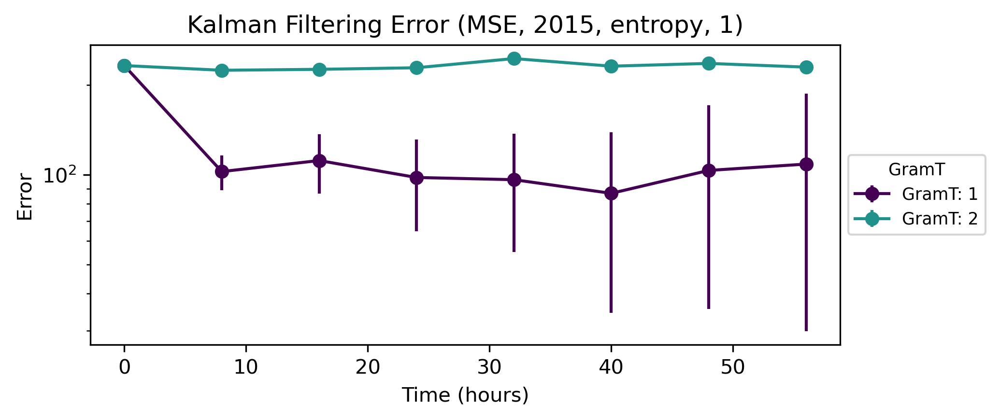

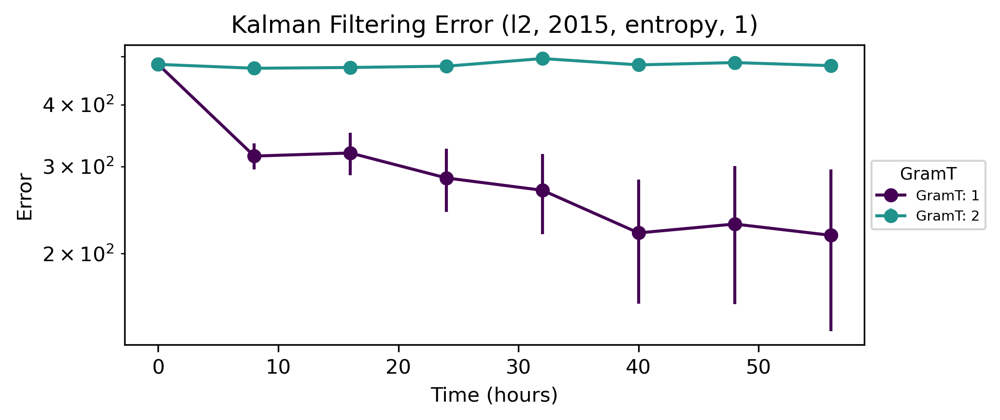

2015entropy5


/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


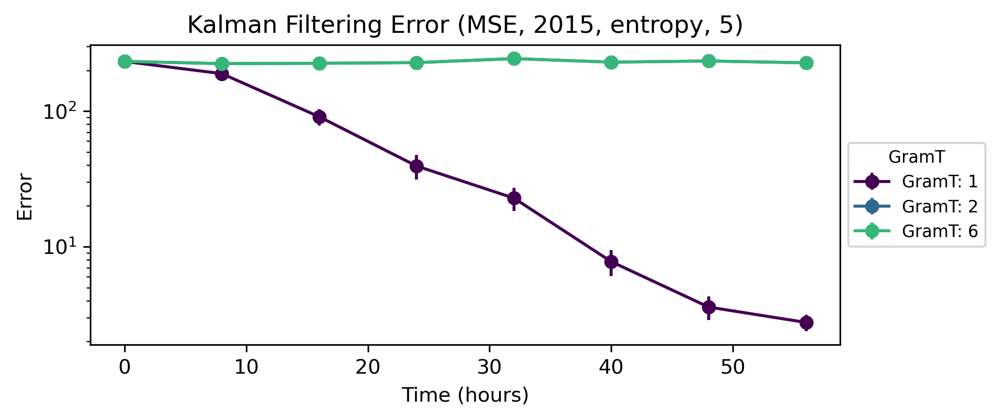

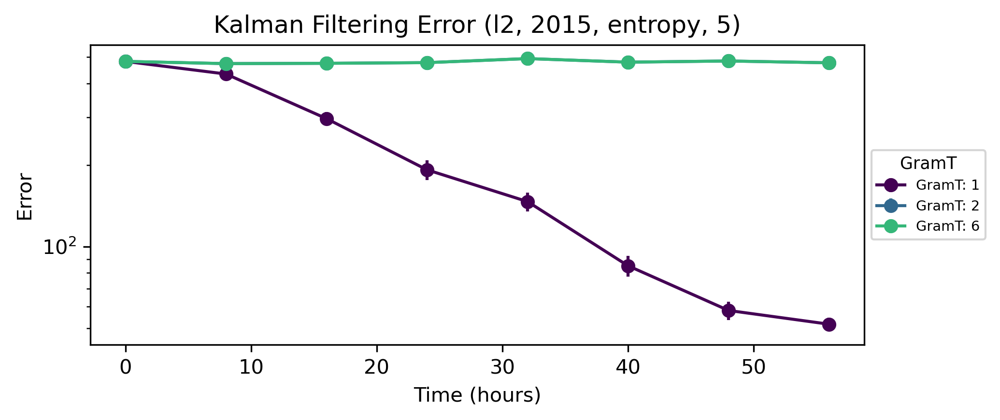

2015entropy10


/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


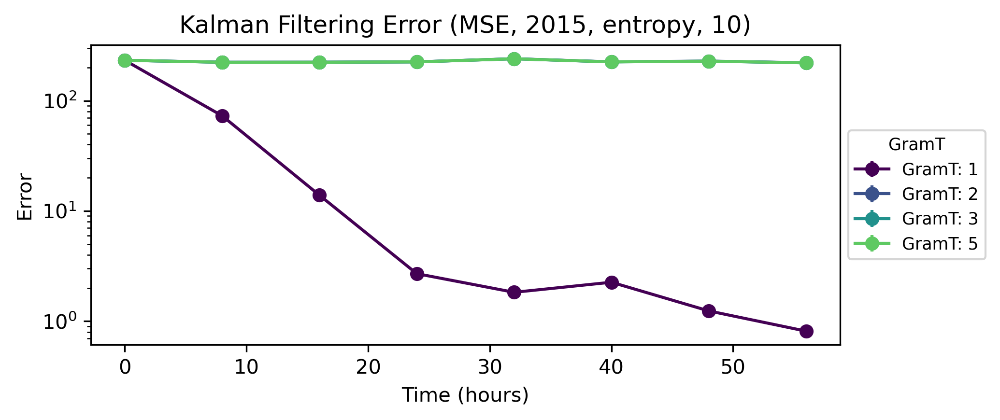

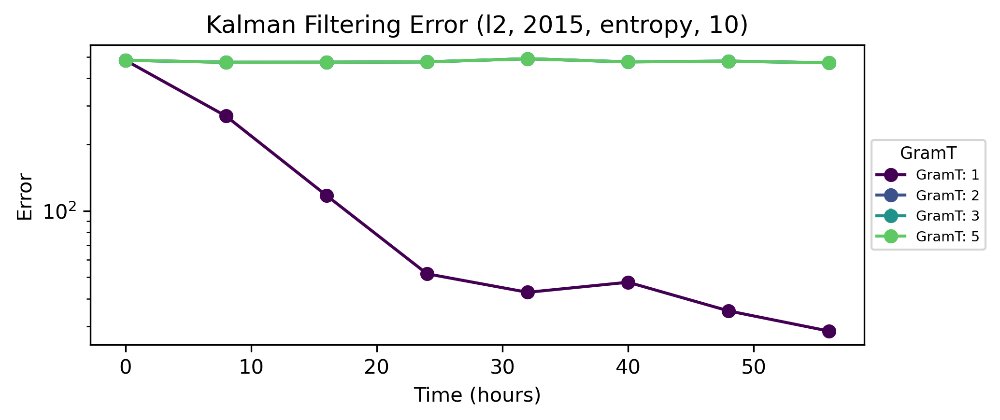

2015entropy25


/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


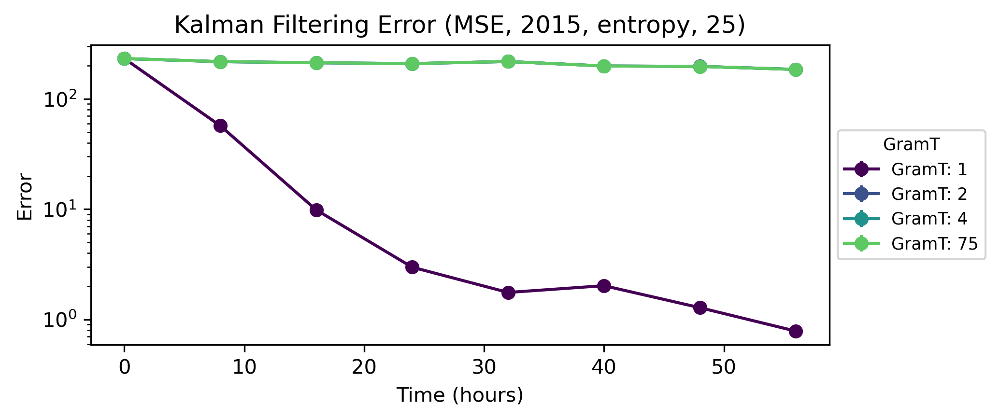

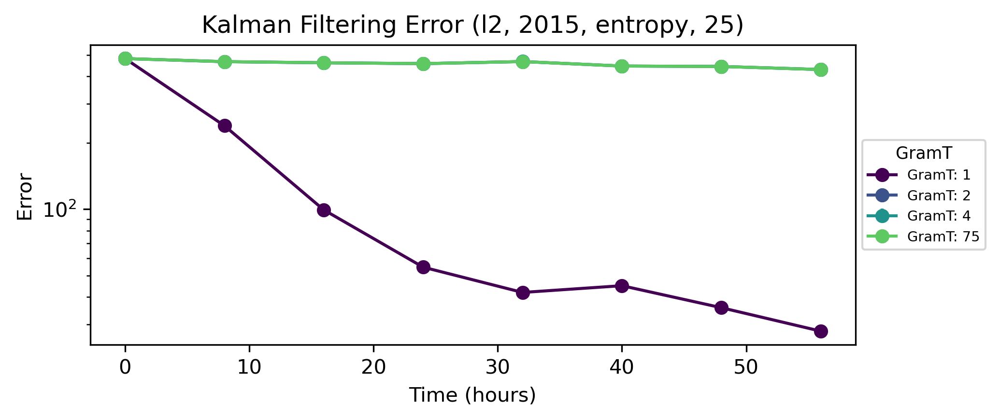

2015entropy50


/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


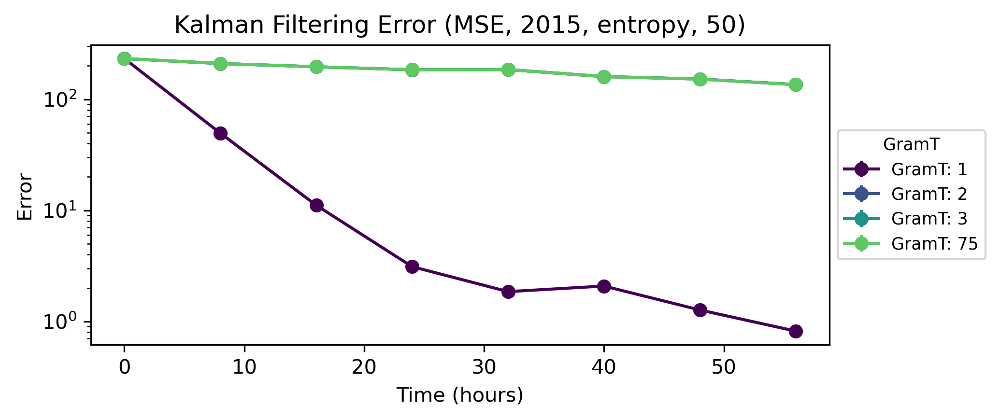

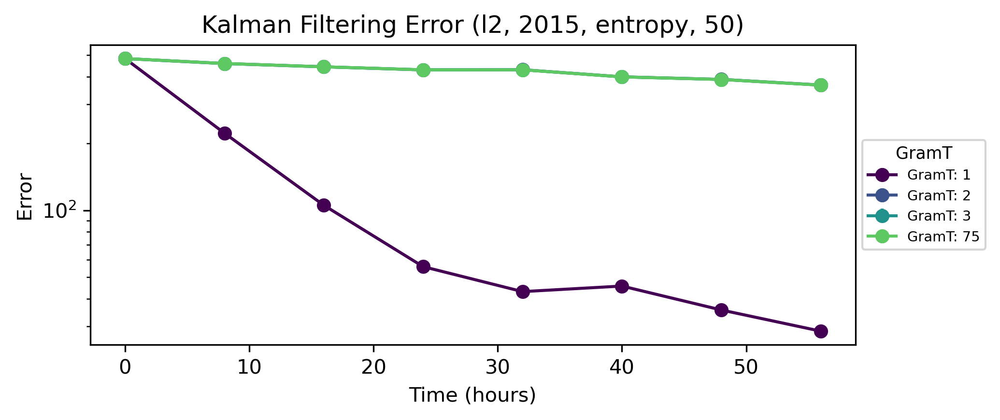

2015entropy75


/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


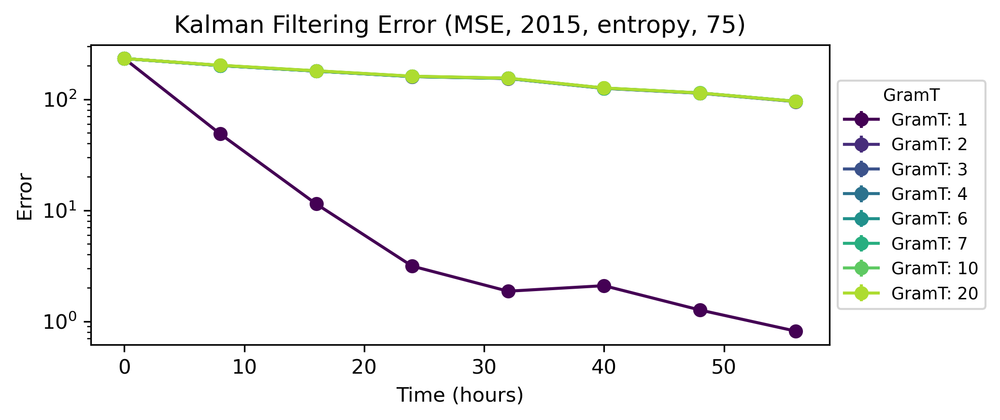

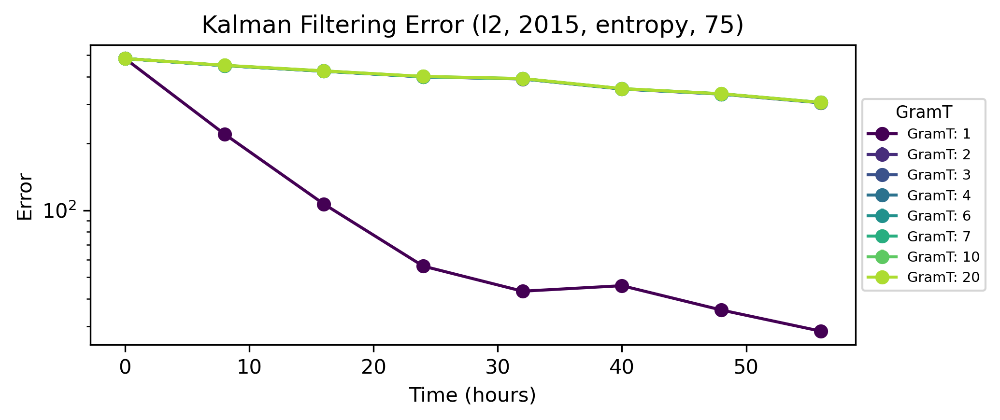

2015entropy100


/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


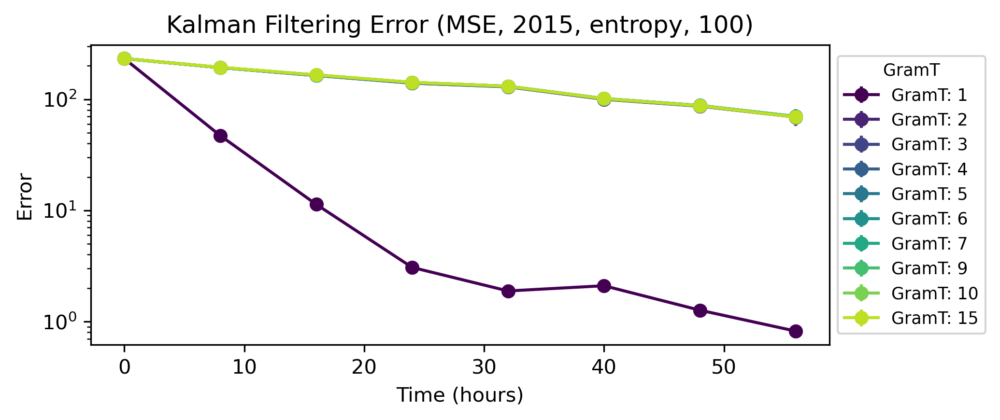

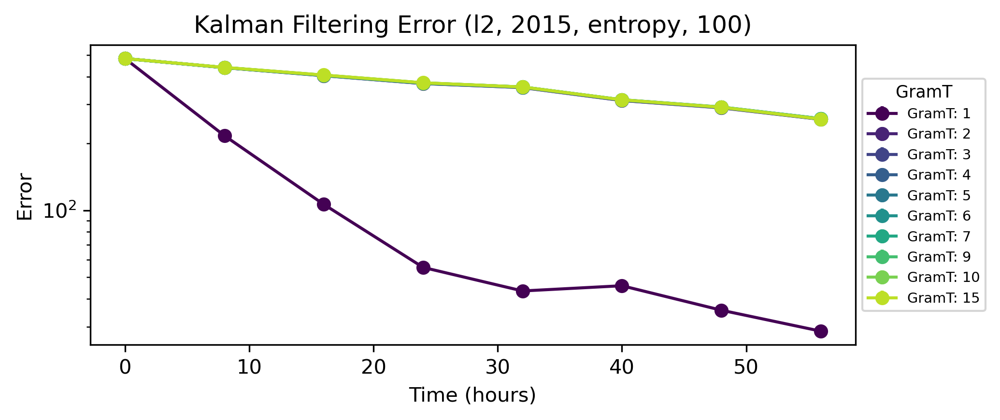

2015avg1


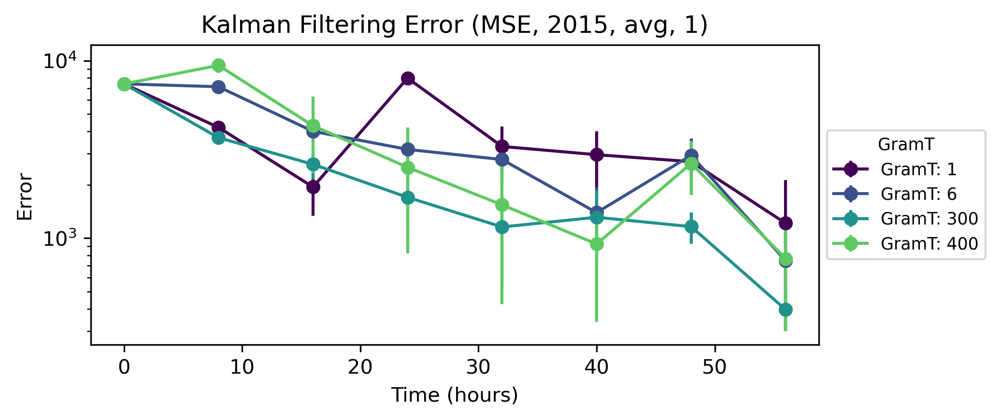

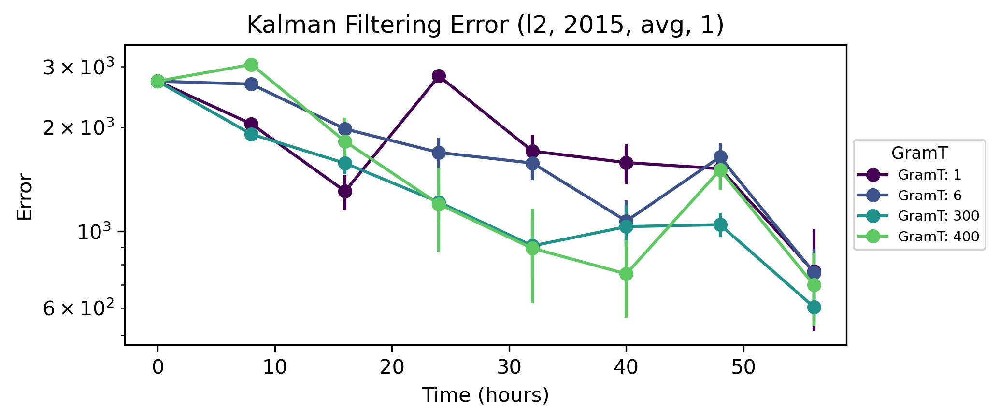

2015avg5


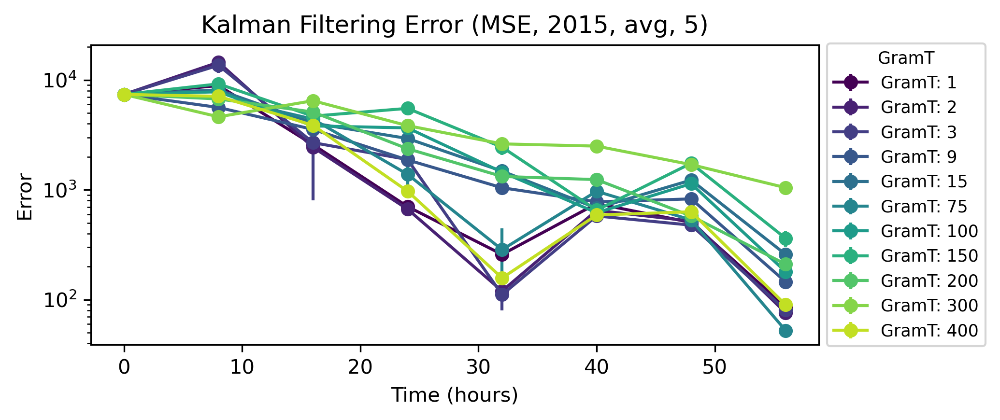

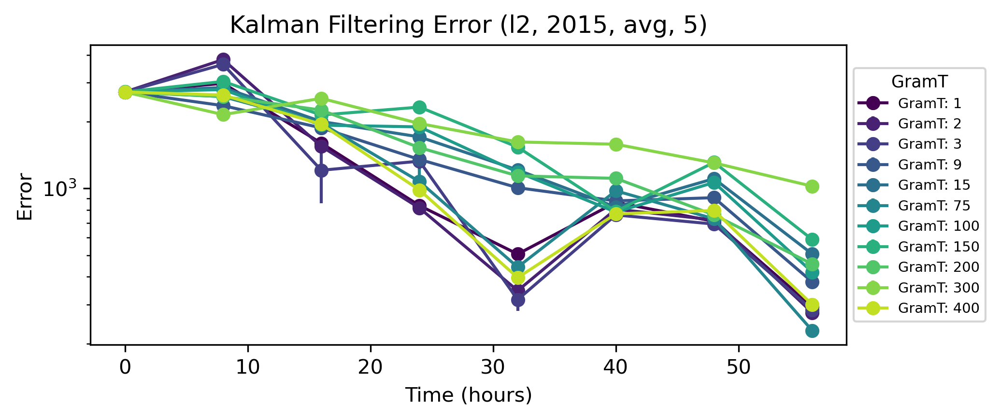

2015avg10


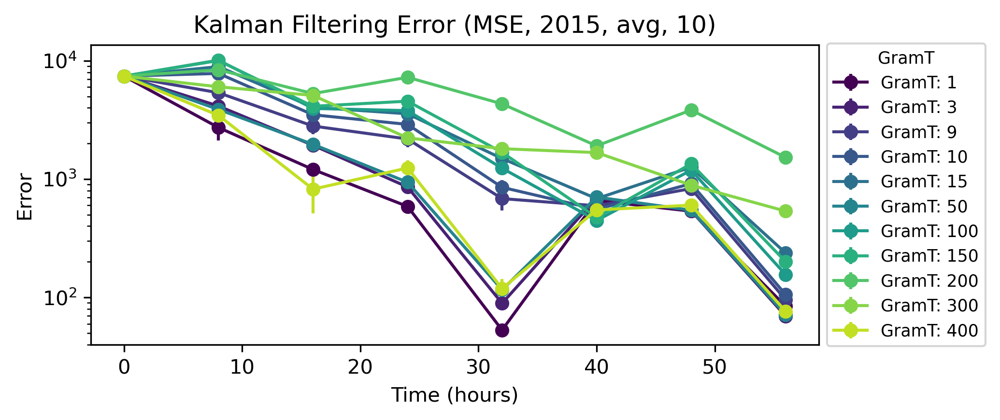

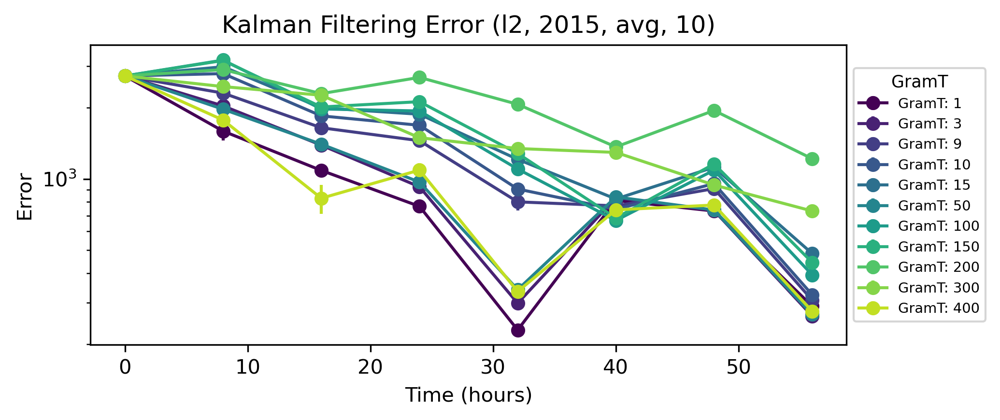

2015avg25


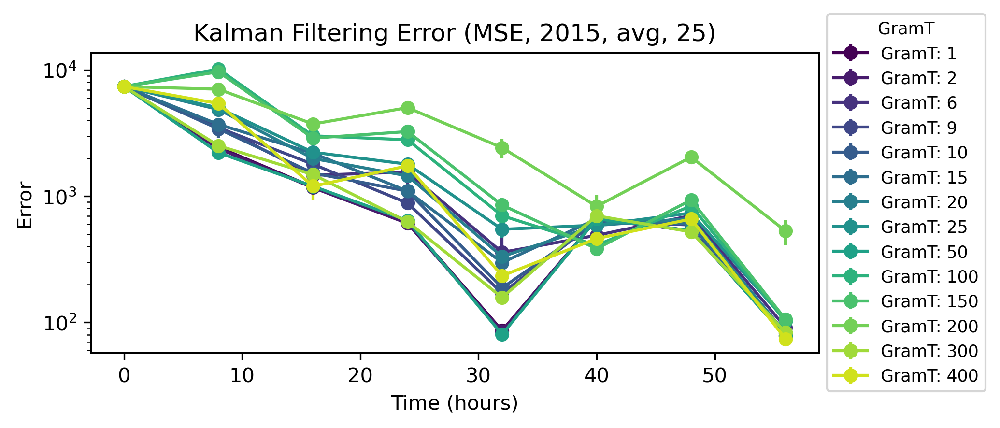

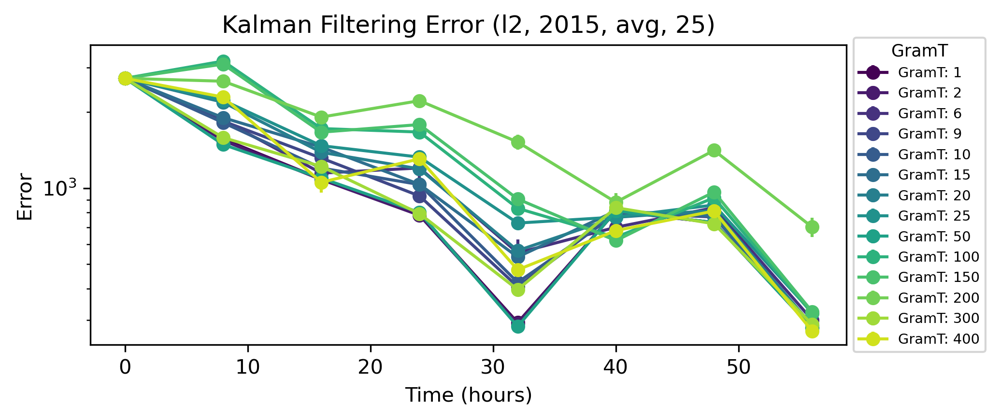

2015avg50


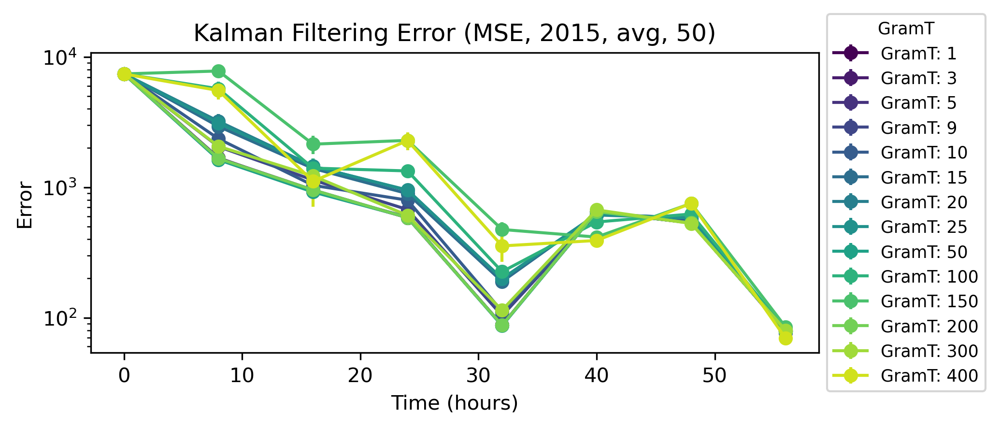

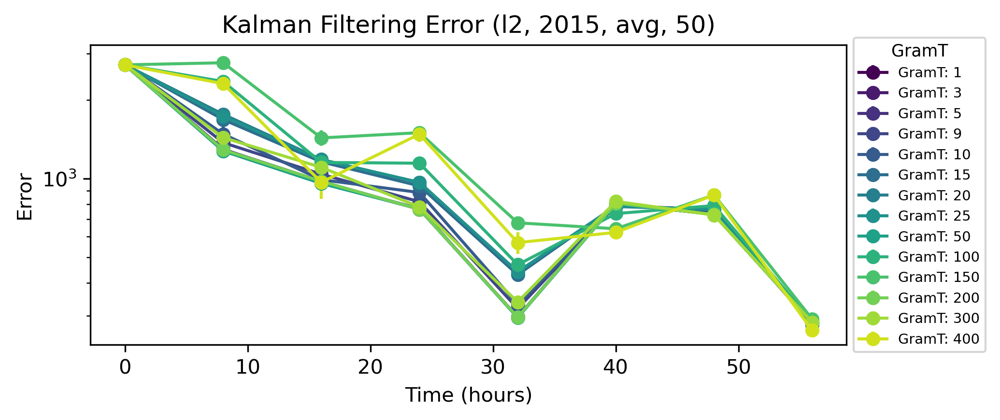

2015avg75


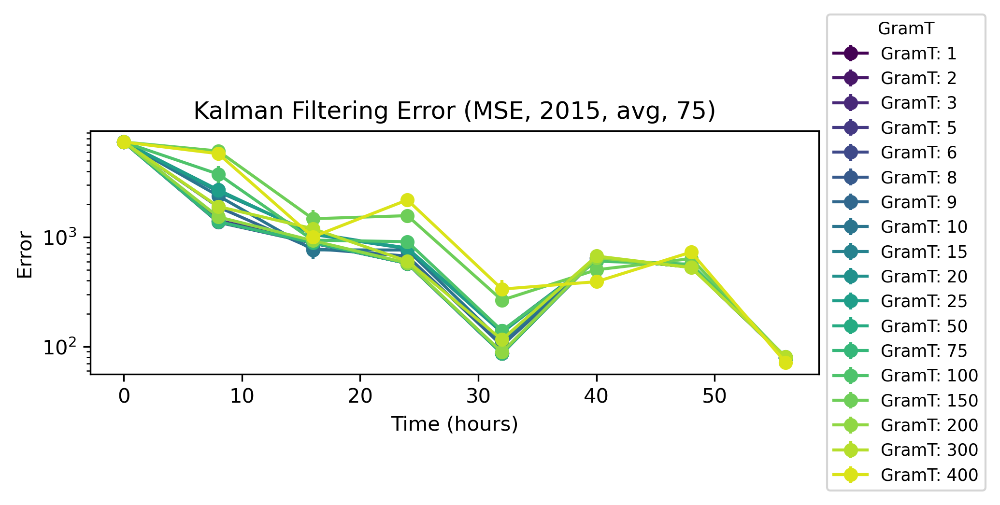

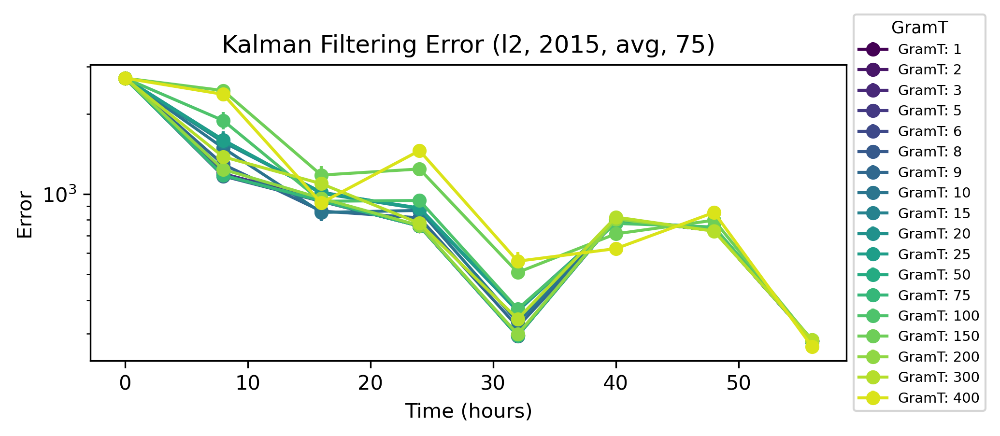

2015avg100


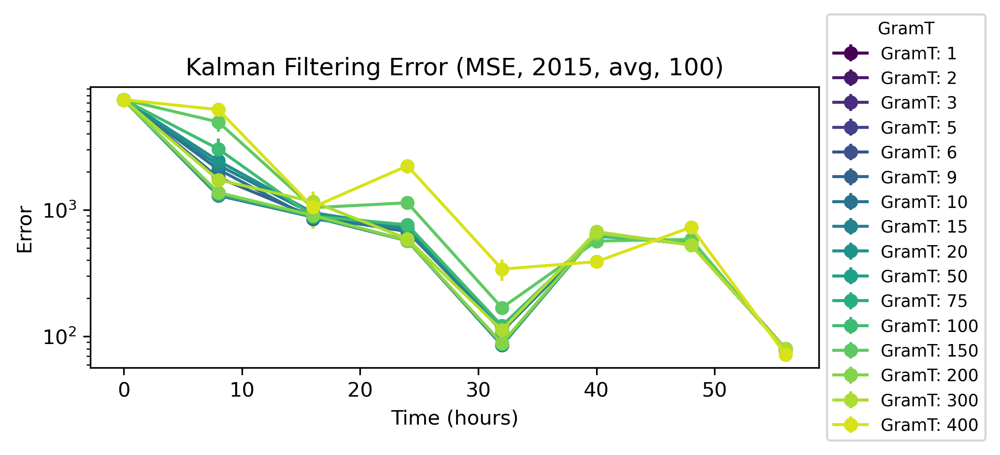

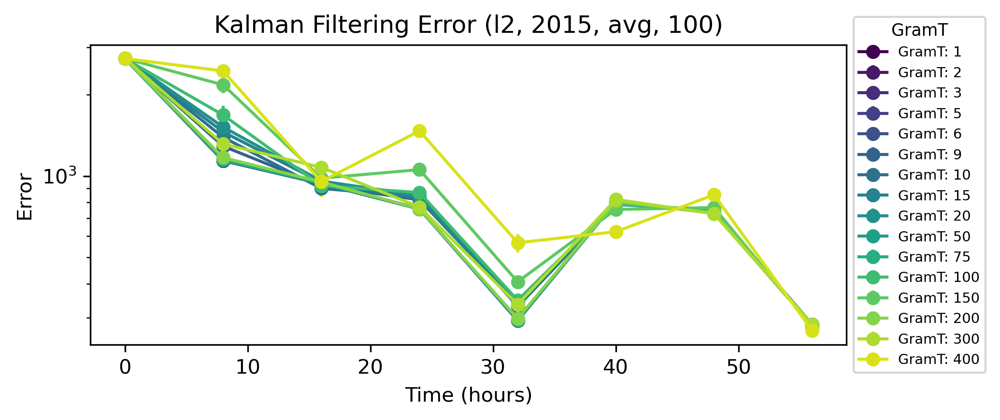

<Figure size 2100x900 with 0 Axes>

In [27]:
# visualize the above filterings
itr = generate_combinations(ds, selectionCriteria, numSensors)
for simArgs['year'], simArgs['criteria'], simArgs['nSensors'] in itr:
    print(simArgs['year'] + simArgs['criteria'] + str(simArgs['nSensors']))
    estimatorSet = out[simArgs['year'] + simArgs['criteria'] + str(simArgs['nSensors'])]
    dmd_data_2015, dmd_data_2018, gene_list_separate = filterGeneSet(tpm_2015, tpm_2018, 
                                                        k=simArgs['nGenes'],
                                                        criteria=simArgs['criteria'],
                                                        mergeGeneSets=False)
    gene_list_separate = {'2015': gene_list_separate[0],
                          '2018': gene_list_separate[1]}
    trajectories = {'2015': dmd_data_2015,
                    '2018': dmd_data_2018}
    gene_list = gene_list_separate[simArgs['year']]
    trajectory = trajectories[simArgs['year']]
    
    keys = list(estimatorSet.keys())
    keys.sort()

    ## MSE plot
    colormap = plt.cm.viridis
    for gramT in keys:
        MSE = []
        trajs = estimatorSet[gramT]
        for t in range(trajectory.shape[1]):
            mse = []
            for i in range(nsims):
                trajectoriesHat = trajs[i]
                mse.append((np.square(trajectory[:,t,0] - trajectoriesHat[:,t])).mean())
            MSE.append(mse)
        MSE = np.array(MSE)
        mse_mean_values = np.mean(MSE, axis=1)
        mse_std_errors = np.std(MSE, axis=1) / np.sqrt(MSE.shape[1])
        xrange = 8 * np.array(range(mse_mean_values.shape[0]))
        color = colormap(keys.index(gramT) / len(keys))
        plt.errorbar(xrange, mse_mean_values, yerr=mse_std_errors, fmt='-o', label='GramT: ' + str(gramT), color=color)
    plt.xlabel('Time (hours)')
    plt.ylabel('Error')
    plt.yscale('log')
    plt.title('Kalman Filtering Error (MSE, ' + simArgs['year'] + ', ' + simArgs['criteria'] + ', ' + str(simArgs['nSensors']) + ')')
    legend = plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), fontsize='small')
    legend.set_title('GramT', prop={'size': 'small'})
    plt.tight_layout()
    plt.show()
    figName = 'GramTstability_KF_MSE' + fnameArgs(simArgs) + '.png'
    plt.savefig(outPath + figName)
    plt.savefig(curPath + '/figures/' + figName)

    for gramT in keys:
        L2 = []
        trajs = estimatorSet[gramT]
        for t in range(trajectory.shape[1]):
            l2 = []
            for i in range(nsims):
                trajectoriesHat = trajs[i]
                l2.append(np.linalg.norm(trajectory[:,t,0] - trajectoriesHat[:,t]))
            L2.append(l2)
        L2 = np.array(L2)
        l2_mean_values = np.mean(L2, axis=1)
        l2_std_errors = np.std(L2, axis=1) / np.sqrt(L2.shape[1])
        xrange = 8 * np.array(range(mse_mean_values.shape[0]))
        color = colormap(keys.index(gramT) / len(keys))
        plt.errorbar(xrange, l2_mean_values, yerr=l2_std_errors, fmt='-o', label='GramT: ' + str(gramT), color=color)
    plt.xlabel('Time (hours)')
    plt.ylabel('Error')
    plt.yscale('log')
    plt.title('Kalman Filtering Error (l2, ' + simArgs['year'] + ', ' + simArgs['criteria'] + ', ' + str(simArgs['nSensors']) + ')')
    legend = plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), fontsize='x-small')
    legend.set_title('GramT', prop={'size': 'small'})
    plt.tight_layout()
    plt.show()
    figName = 'GramTstability_KF_L2' + fnameArgs(simArgs) + '.png'
    plt.savefig(outPath + figName)
    plt.savefig(curPath + '/figures/' + figName)

In [29]:
trajectory[:,:,0].shape

(1000, 8)

### Initial Condition Estimation

In [28]:
ds = ['2015', '2018']
selectionCriteria = ['entropy', 'avg', 'std']
gram_horizons = [1,2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400]
numSensors = list([1, 5, 10, 25, 50, 75, 100])
nGenes = 1000
simArgs = {'year'    : None,
           'criteria': None,
           'nSensors': None,
           'nGenes'  : nGenes,
          }
out = {}

In [29]:
itr = generate_combinations(ds, selectionCriteria, numSensors)
for simArgs['year'], simArgs['criteria'], simArgs['nSensors'] in itr:
    print(simArgs)
    dmd_data_2015, dmd_data_2018, gene_list_separate = filterGeneSet(tpm_2015, tpm_2018, 
                                                        k=simArgs['nGenes'],
                                                        criteria=simArgs['criteria'],
                                                        mergeGeneSets=False)
    gene_list_separate = {'2015': gene_list_separate[0],
                          '2018': gene_list_separate[1]}
    trajectories = {'2015': dmd_data_2015,
                    '2018': dmd_data_2018}
    gene_list = gene_list_separate[simArgs['year']]
    trajectory = trajectories[simArgs['year']]
    
    estimatorSet = {}
    usedC = []
    predictions = {}
    for gramT in gram_horizons:
        print(gramT, end=',')
        ss = sensorSelection.hasnain2023(trajectory, dmd_rank=7, gramT=gramT, vxNames=gene_list)

        A = ss['dmd']['A']
        sensors = ss['sensors']
        sensorGenes = sensors['gene'].values[:simArgs['nSensors']]
        idxs = [list(gene_list).index(gene) for gene in sensorGenes]
        idxs.sort()
        C = getC(A.shape[0], idxs)
        
        #isused = any(np.array_equal(C, arr) for arr in usedC)
        #if isused:
            # print('    Stable Sensors (Prediction skipped)')
        #    continue
        #else:
        #    usedC.append(C)
        # print('build O')
        O = obsv(A,C,trajectory.shape[1])                # observability matrix
        # print(O.shape)
        outputs = C @ trajectory[:,:,1] # system output
        outputs = outputs.ravel()
        # print(outputs.shape)
        Opinv = np.linalg.pinv(O)       # pseudo inverse
        # print(Opinv.shape)
        X0hat = Opinv @ outputs         # predicted initial conditions: Hasnain eq. 18
        # print(X0hat.shape)
        predictions[gramT] = X0hat
    out[simArgs['year'] + simArgs['criteria'] + str(simArgs['nSensors'])] = predictions

{'year': '2015', 'criteria': 'entropy', 'nSensors': 1, 'nGenes': 1000}
1,

/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2015', 'criteria': 'entropy', 'nSensors': 5, 'nGenes': 1000}
1,

/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2015', 'criteria': 'entropy', 'nSensors': 10, 'nGenes': 1000}
1,

/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2015', 'criteria': 'entropy', 'nSensors': 25, 'nGenes': 1000}
1,

/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2015', 'criteria': 'entropy', 'nSensors': 50, 'nGenes': 1000}
1,

/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2015', 'criteria': 'entropy', 'nSensors': 75, 'nGenes': 1000}
1,

/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2015', 'criteria': 'entropy', 'nSensors': 100, 'nGenes': 1000}
1,

/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2015', 'criteria': 'avg', 'nSensors': 1, 'nGenes': 1000}
1,2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2015', 'criteria': 'avg', 'nSensors': 5, 'nGenes': 1000}
1,2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2015', 'criteria': 'avg', 'nSensors': 10, 'nGenes': 1000}
1,2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2015', 'criteria': 'avg', 'nSensors': 25, 'nGenes': 1000}
1,2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2015', 'criteria': 'avg', 'nSensors': 50, 'nGenes': 1000}
1,2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2015', 'criteria': 'avg', 'nSensors': 75, 'nGenes': 1000}
1,2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2015', 'criteria': 'avg', 'nSensors': 100, 'nGenes': 1000}
1,2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2015', 'criteria': 'std', 'nSensors': 1, 'nGenes': 1000}
1,2,3,4,5,6,

/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2018', 'criteria': 'entropy', 'nSensors': 5, 'nGenes': 1000}
1,

/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2018', 'criteria': 'entropy', 'nSensors': 10, 'nGenes': 1000}
1,

/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2018', 'criteria': 'entropy', 'nSensors': 25, 'nGenes': 1000}
1,

/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2018', 'criteria': 'entropy', 'nSensors': 50, 'nGenes': 1000}
1,

/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2018', 'criteria': 'entropy', 'nSensors': 75, 'nGenes': 1000}
1,

/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2018', 'criteria': 'entropy', 'nSensors': 100, 'nGenes': 1000}
1,

/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2018', 'criteria': 'avg', 'nSensors': 1, 'nGenes': 1000}
1,2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2018', 'criteria': 'avg', 'nSensors': 5, 'nGenes': 1000}
1,2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2018', 'criteria': 'avg', 'nSensors': 10, 'nGenes': 1000}
1,2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2018', 'criteria': 'avg', 'nSensors': 25, 'nGenes': 1000}
1,2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2018', 'criteria': 'avg', 'nSensors': 50, 'nGenes': 1000}
1,2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2018', 'criteria': 'avg', 'nSensors': 75, 'nGenes': 1000}
1,2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2018', 'criteria': 'avg', 'nSensors': 100, 'nGenes': 1000}
1,2,3,4,5,6,7,8,9,10,15,20,25,50,75,100,150,200,300,400,{'year': '2018', 'criteria': 'std', 'nSensors': 1, 'nGenes': 1000}
1,2,3,4,5,6,

/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


[1, 5, 10, 25, 50, 75, 100]


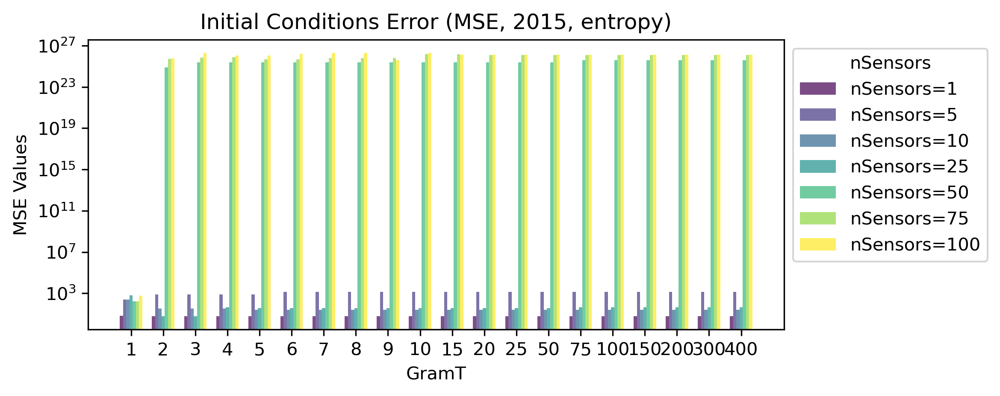

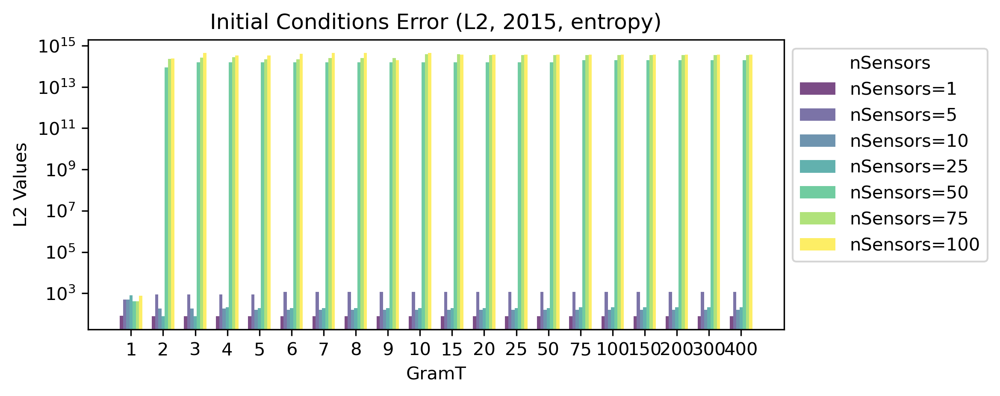

[1, 5, 10, 25, 50, 75, 100]


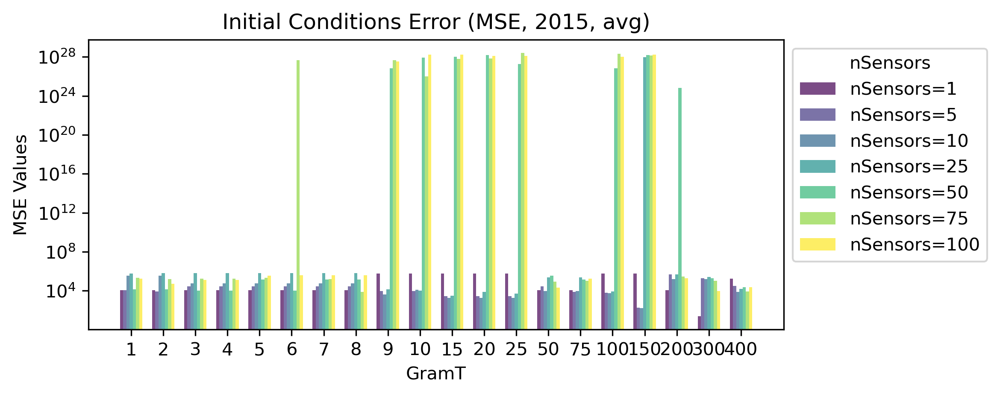

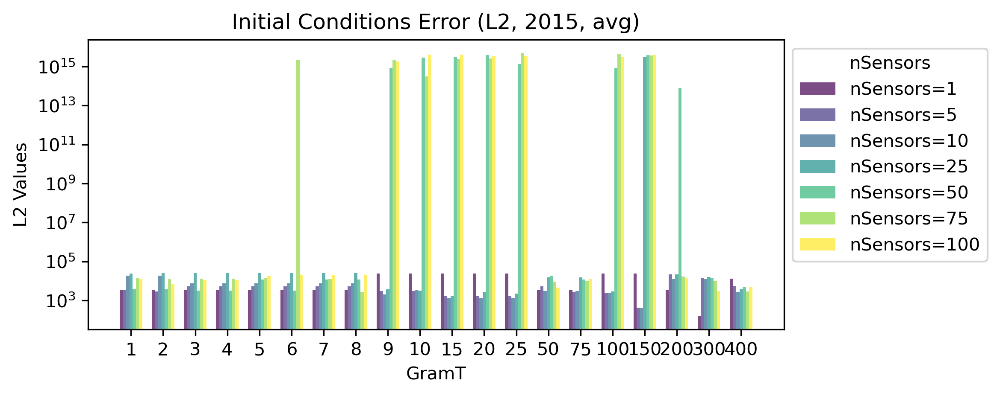

[1, 5, 10, 25, 50, 75, 100]


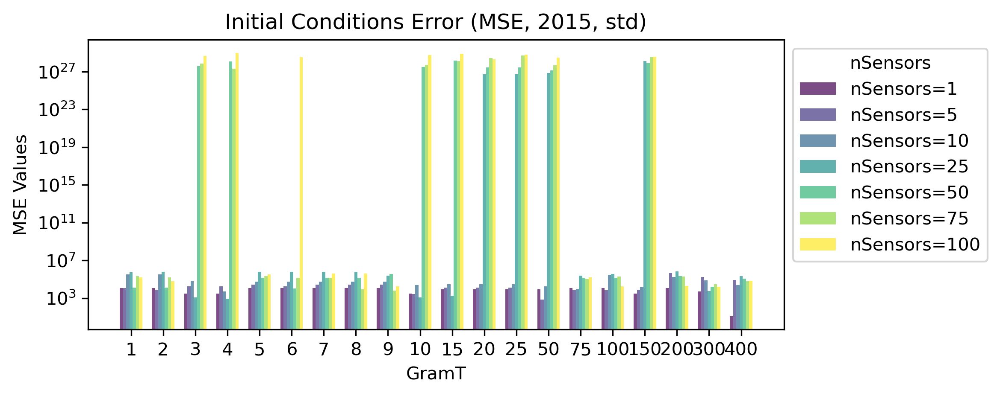

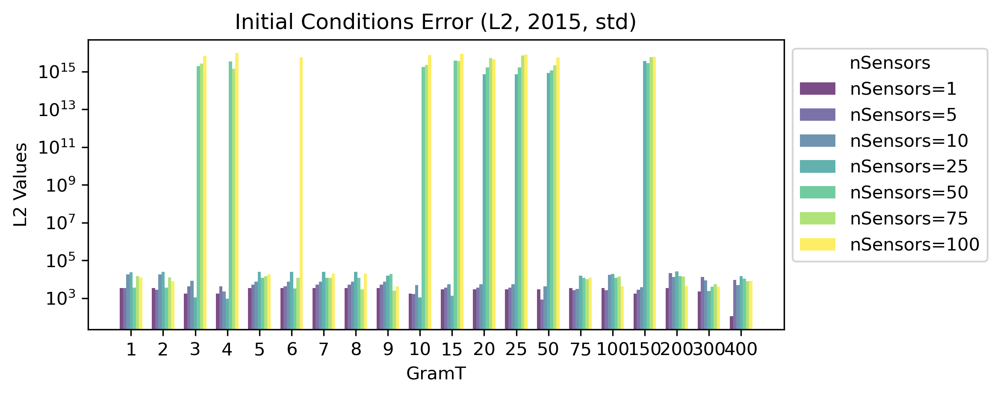

/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


[1, 5, 10, 25, 50, 75, 100]


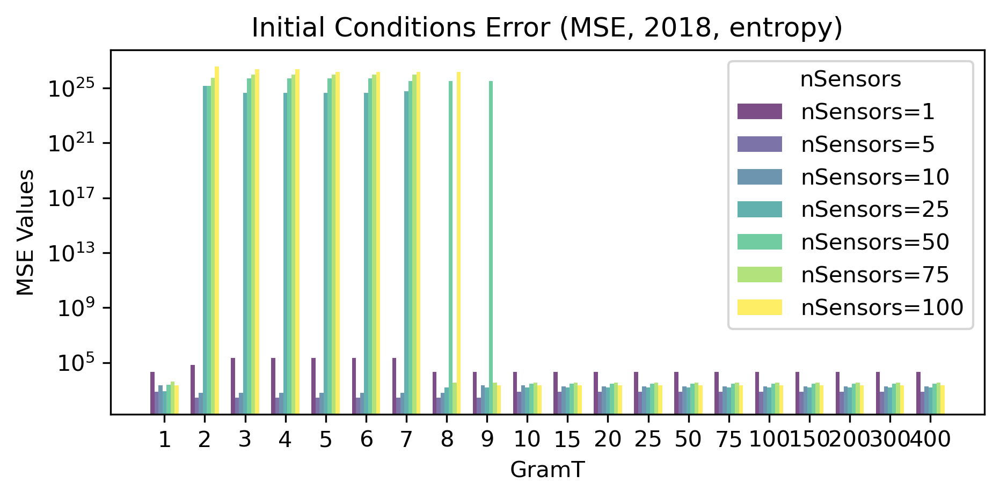

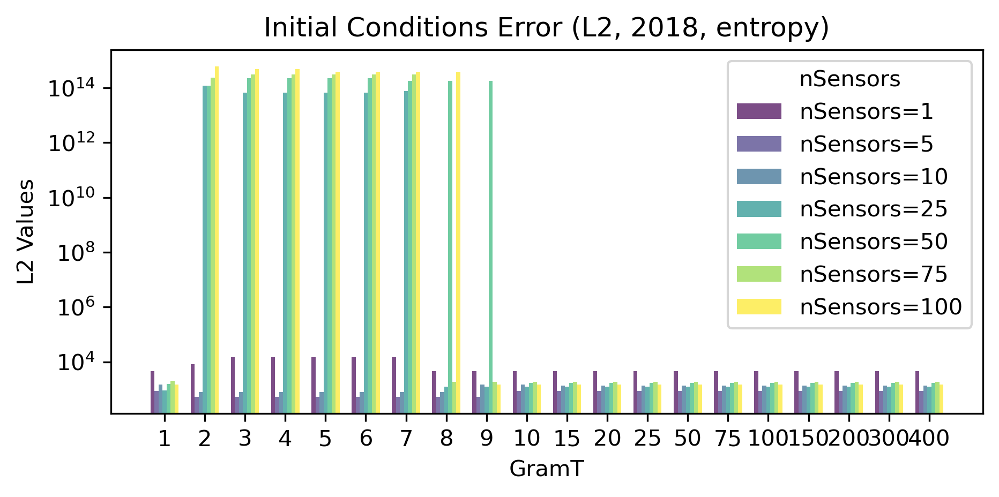

[1, 5, 10, 25, 50, 75, 100]


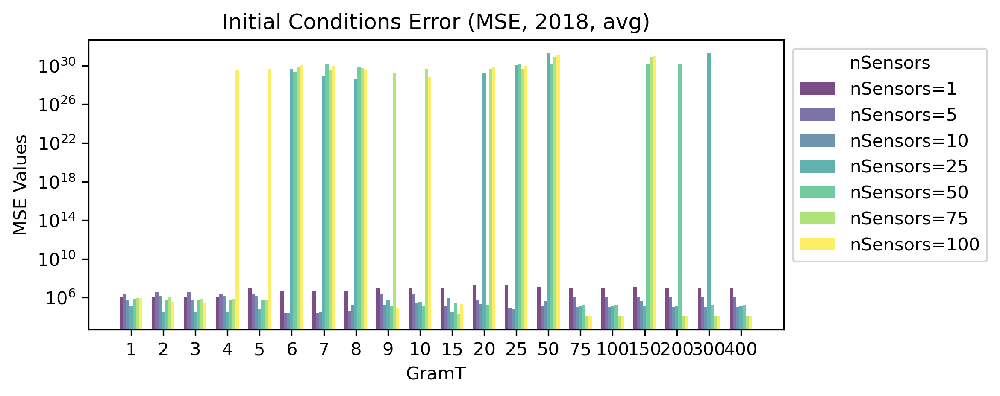

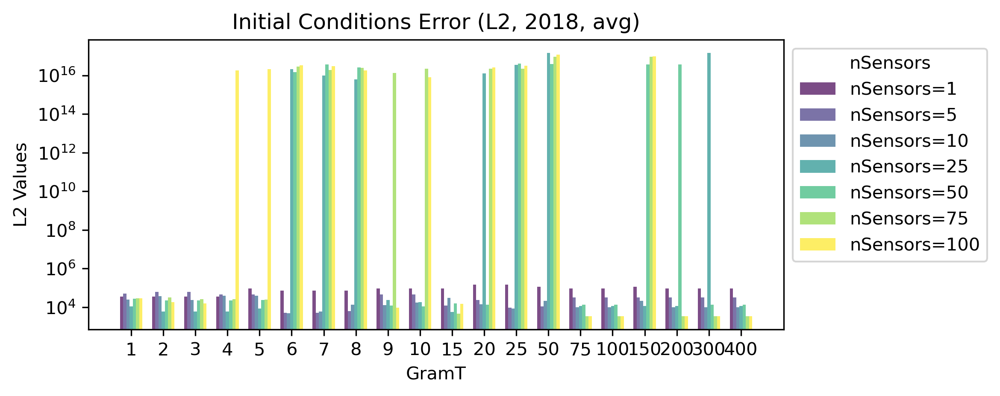

[1, 5, 10, 25, 50, 75, 100]


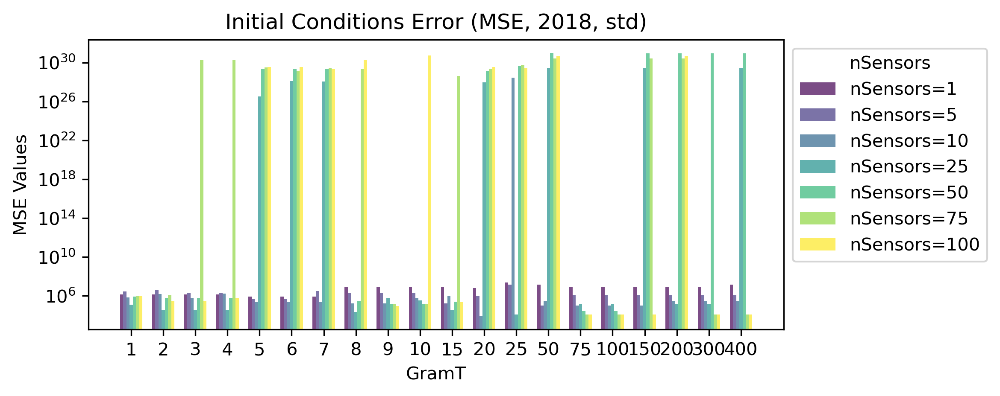

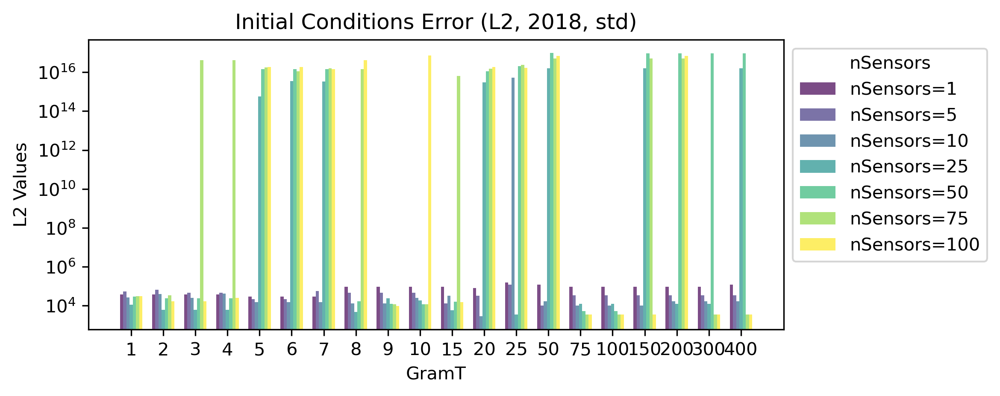

In [30]:
bar_width = 0.1  # Adjust the width based on your preference
positions = np.arange(len(gram_horizons))

itr = generate_combinations(ds, selectionCriteria)
for simArgs['year'], simArgs['criteria'] in itr:
    dmd_data_2015, dmd_data_2018, gene_list_separate = filterGeneSet(tpm_2015, tpm_2018, 
                                                    k=simArgs['nGenes'],
                                                    criteria=simArgs['criteria'],
                                                    mergeGeneSets=False)
    gene_list_separate = {'2015': gene_list_separate[0],
                          '2018': gene_list_separate[1]}
    trajectories = {'2015': dmd_data_2015,
                    '2018': dmd_data_2018}
    gene_list = gene_list_separate[simArgs['year']]
    trajectory = trajectories[simArgs['year']]
    X0 = trajectory[:,0,1]
    GT = {}
    MSE = {}
    L2 = {}
    for simArgs['nSensors'] in numSensors:
        predictions = out[simArgs['year'] + simArgs['criteria'] + str(simArgs['nSensors'])]
        usedGramT = list(predictions.keys())
        mse = []
        l2 = []
        for gramT in usedGramT:
            X0hat = predictions[gramT]
            mse.append((np.square(X0 - X0hat)).mean())
            l2.append(np.linalg.norm(X0 - X0hat))
        MSE[simArgs['nSensors']] = mse
        L2[simArgs['nSensors']] = l2
        GT[simArgs['nSensors']] = usedGramT
        
    #print(MSE[1])
    #print(MSE[2])
        
    nSensors_values = sorted(MSE.keys())

    print(nSensors_values)
    
    # Colors based on the ordinal value of nSensors
    colors = plt.cm.viridis(np.linspace(0, 1, len(nSensors_values)))

    # Create a stacked bar plot
    fig, ax = plt.subplots()

    for i, nSensors in enumerate(nSensors_values):
        mse_values = MSE[nSensors]
        gramT_values = GT[nSensors]
        bars = ax.bar(positions + i * bar_width, mse_values, width=bar_width, label=f'nSensors={nSensors}', color=colors[i], alpha=0.7)
    ax.set_xlabel('GramT')
    ax.set_ylabel('MSE Values')
    ax.set_title('Initial Conditions Error (MSE, ' + simArgs['year'] + ', ' + simArgs['criteria'] + ')')
    ax.legend(title='nSensors', bbox_to_anchor=(1, 1))
    ax.set_xticks(positions + (len(nSensors_values) - 1) * bar_width / 2)
    ax.set_xticklabels(gram_horizons)
    ax.set_yscale('log')
    plt.show()
    
    fig, ax = plt.subplots()
    for i, nSensors in enumerate(nSensors_values):
        l2_values = L2[nSensors]
        gramT_values = GT[nSensors]
        bars = ax.bar(positions + i * bar_width, l2_values, width=bar_width, label=f'nSensors={nSensors}', color=colors[i], alpha=0.7)
        ax.set_xlabel('GramT')
    ax.set_ylabel('L2 Values')
    ax.set_title('Initial Conditions Error (L2, ' + simArgs['year'] + ', ' + simArgs['criteria'] + ')')
    ax.legend(title='nSensors', bbox_to_anchor=(1, 1))
    ax.set_xticks(positions + (len(nSensors_values) - 1) * bar_width / 2)
    ax.set_xticklabels(gram_horizons)
    ax.set_yscale('log')
    plt.show()

    

/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


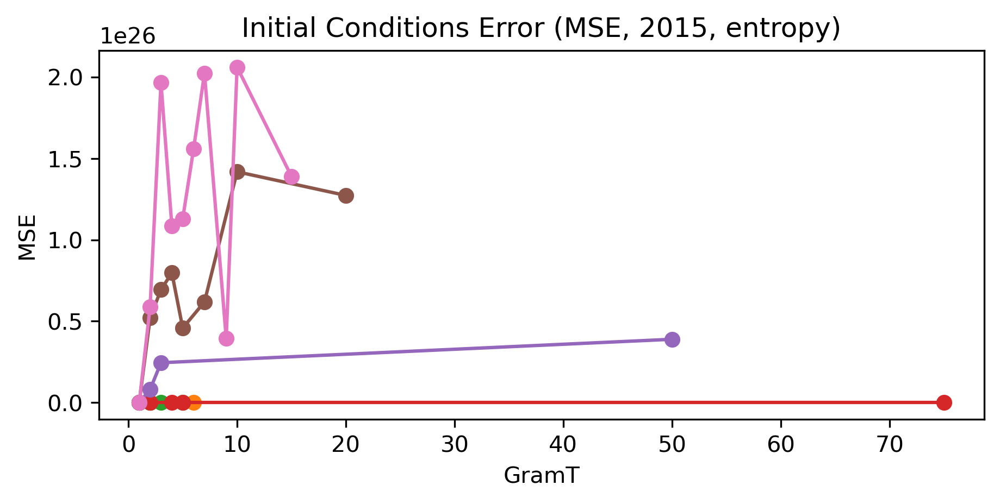

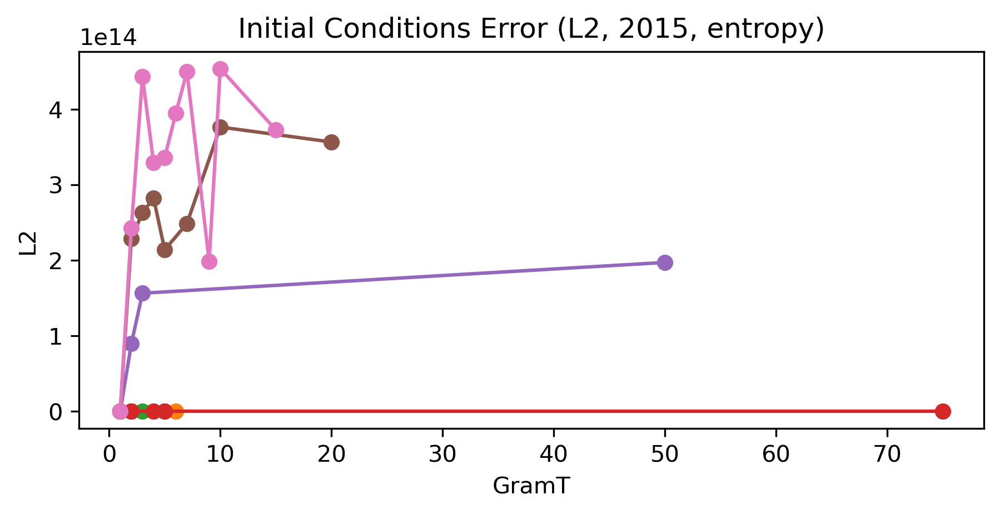

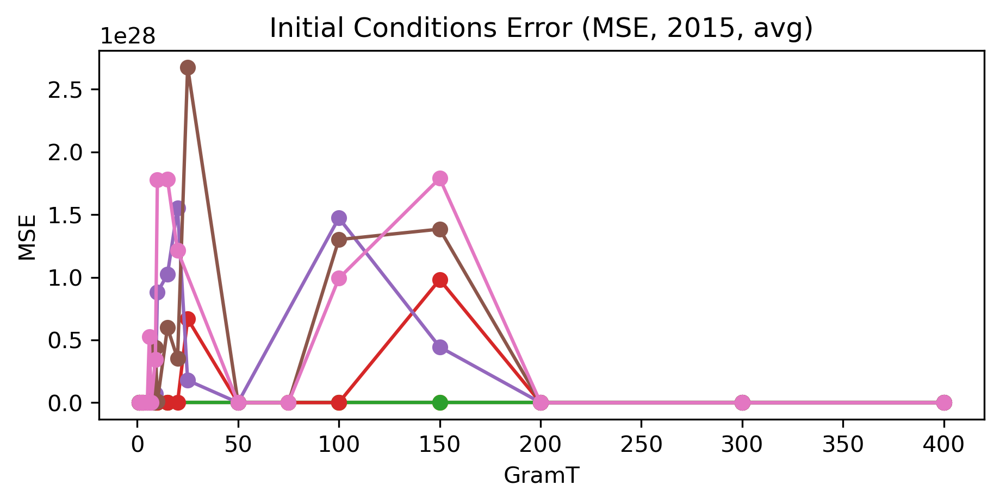

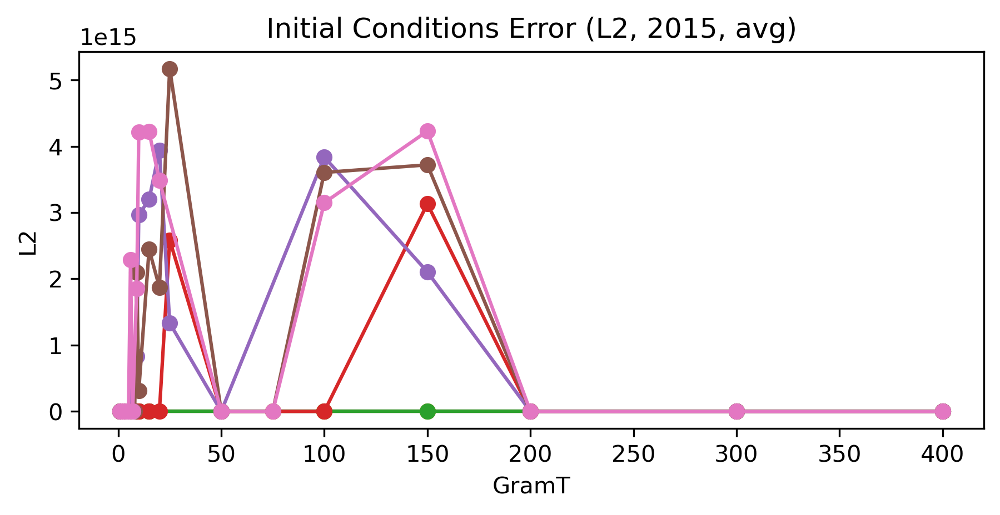

In [35]:
itr = generate_combinations(ds, selectionCriteria)
for simArgs['year'], simArgs['criteria'] in itr:
    dmd_data_2015, dmd_data_2018, gene_list_separate = filterGeneSet(tpm_2015, tpm_2018, 
                                                    k=simArgs['nGenes'],
                                                    criteria=simArgs['criteria'],
                                                    mergeGeneSets=False)
    gene_list_separate = {'2015': gene_list_separate[0],
                          '2018': gene_list_separate[1]}
    trajectories = {'2015': dmd_data_2015,
                    '2018': dmd_data_2018}
    gene_list = gene_list_separate[simArgs['year']]
    trajectory = trajectories[simArgs['year']]
    X0 = trajectory[:,0,1]
    GT = {}
    MSE = {}
    L2 = {}
    for simArgs['nSensors'] in numSensors:
        predictions = out[simArgs['year'] + simArgs['criteria'] + str(simArgs['nSensors'])]
        usedGramT = list(predictions.keys())
        mse = []
        l2 = []
        for gramT in usedGramT:
            X0hat = predictions[gramT]
            mse.append((np.square(X0 - X0hat)).mean())
            l2.append(np.linalg.norm(X0 - X0hat))
        MSE[simArgs['nSensors']] = mse
        L2[simArgs['nSensors']] = l2
        GT[simArgs['nSensors']] = usedGramT
        
    for simArgs['nSensors'] in numSensors:
        plt.plot(GT[simArgs['nSensors']], MSE[simArgs['nSensors']], '-o')
    plt.xlabel('GramT')
    plt.ylabel('MSE')
    plt.title('Initial Conditions Error (MSE, ' + simArgs['year'] + ', ' + simArgs['criteria'] + ')')
    plt.show()
    
    for simArgs['nSensors'] in numSensors:
        plt.plot(GT[simArgs['nSensors']], L2[simArgs['nSensors']], '-o')
    plt.xlabel('GramT')
    plt.ylabel('L2')
    plt.title('Initial Conditions Error (L2, ' + simArgs['year'] + ', ' + simArgs['criteria'] + ')')
    plt.show()
    
    

In [10]:
C @ trajectory[:,:,1]

array([[148.47864645, 140.07864473, 139.11539371, 143.75678699,
        157.60893838, 150.24757248, 156.42515193, 159.02582981]])

In [31]:
tpm_2018.shape

(19235, 48)

## Stability of Submodular Optimization

How do the top ranked genes vary as more iterations of the submodular optimization are used?

* for each data set 
* for 3 gene selection criteria
* for many values in the Gram matrix summation
* rank the genes as sensors according to the Gram matrix weights

visualize how the rankings change as the Gram computation varies

In [47]:
df = pd.read_csv('submodularOpt/geneNames_std_filtered_A_thresh_1.csv')


### Improved Speed of Submodular Optimization based on Stability

## Compare Submodular Optimization vs Gram Matrix vs Entropy

### How much overlap do the top sensor have with one another?
(Ven Diagram)

In [124]:
nSensors = 100

In [128]:
# Get most entropic genes
_, _, gene_sets = filterGeneSet(tpm_2015, tpm_2018, k=nSensors, criteria='entropy', mergeGeneSets=False)
entropy_2015 = set(gene_sets[0])
entropy_2018 = set(gene_sets[1])


/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


In [127]:
set(entropy_2015)

{'ABRAXAS2',
 'ACIN1',
 'ADIPOR2',
 'ADNP',
 'AMMECR1L',
 'ANKRD17',
 'AP3M1',
 'ARMH3',
 'ARPP19',
 'ATP6V1A',
 'ATXN10',
 'C1orf43',
 'CAPNS1',
 'CAPZB',
 'CCNK',
 'CEBPG',
 'CHMP2A',
 'CLPX',
 'COPA',
 'CPNE1',
 'CSNK2A1',
 'CUX1',
 'DCTN2',
 'DCTN5',
 'DDX3X',
 'DNASE1',
 'DSE',
 'DYNC1H1',
 'ECD',
 'ECPAS',
 'EIF1',
 'EIF2AK1',
 'EIF2S3',
 'EIF3I',
 'EIF3M',
 'EXOC3',
 'EZR',
 'FAM120A',
 'FARP2',
 'FBXL3',
 'FCHSD2',
 'FEM1B',
 'FKBP1A',
 'GIGYF2',
 'GORASP2',
 'HDLBP',
 'HECTD1',
 'HINT1',
 'HK1',
 'KCTD10',
 'KCTD20',
 'KPNA1',
 'KPNA6',
 'LARP1',
 'MAPK14',
 'MBTPS1',
 'MCCC2',
 'MLEC',
 'MRPS27',
 'MSL1',
 'MTERF4',
 'NCOR1',
 'NDUFA10',
 'NUDT16',
 'OXA1L',
 'PIP4K2B',
 'PITPNB',
 'PRPF18',
 'PRPSAP2',
 'PRRC2C',
 'PSME1',
 'QARS1',
 'RAB7A',
 'ROCK1',
 'RTF1',
 'SCAF8',
 'SEC24C',
 'SELENOT',
 'SLC38A1',
 'SMARCB1',
 'SMARCC1',
 'SNRPA',
 'SNX1',
 'SPATA21',
 'STT3B',
 'TFG',
 'TMOD1',
 'TPP2',
 'TRAM2',
 'UBP1',
 'UQCRC2',
 'USP15',
 'VDAC1',
 'WAPL',
 'WNK1',
 'XBP1',
 'Y

### Which pathways/processes are most implicated in the different sensor selections?
GO enrichment

# Compare 2015 vs 2018 Sensor Selection

# Kalman Filtering

## Kalman Filtering 2015 and 2018 data sets (independent gene set)

In [110]:
selectionCriteria = ['entropy', 'avg', 'std']
nSensors = [1, 2, 3, 5, 10, 50, 100, 200]
nGenes = 1000
gramT = 50
nsims = 3
ds = {}

In [114]:
for criteria in selectionCriteria:
    print('Criteria: ' + criteria)
    dmd_data_2015, dmd_data_2018, gene_list_separate = filterGeneSet(tpm_2015, tpm_2018, 
                                                            k=nGenes, 
                                                            criteria=criteria,
                                                            mergeGeneSets=False)
    gene_list_separate = {'2015': gene_list_separate[0],
                          '2018': gene_list_separate[1]}
    trajectories = {'2015': dmd_data_2015,
                    '2018': dmd_data_2018}
    ss2015 = sensorSelection.hasnain2023(dmd_data_2015, dmd_rank=7, gramT=gramT, vxNames=gene_list_separate['2015'])
    ss2018 = sensorSelection.hasnain2023(dmd_data_2018, dmd_rank=7, gramT=gramT, vxNames=gene_list_separate['2018'])
    ds[criteria + '_2015'] = {
                                'ss': ss2015
                             }
    ds[criteria + '_2018'] = {
                                'ss': ss2018
                             }
    for year in ['2015', '2018']:
        trajectory = trajectories[year]
        gene_list = gene_list_separate[year]
        print('Dataset: ' + year)
        print('    trajectory.shape: ' + str(trajectory.shape))
        ss = ds[criteria + '_' + year]['ss']
        estimatorSet = {}
        for numSensors in nSensors: #[3, 5, 7, 10, 12, 15, 17]:
            print('    Num. Sensors:' + str(numSensors))
            A = ss['dmd']['A']
            sensors = ss['sensors']
            sensorGenes = sensors['gene'].values[:numSensors]
            idxs = [list(gene_list).index(gene) for gene in sensorGenes]
            C = getC(A.shape[0], idxs)

            trajectoryUnfolded = trajectory.reshape([trajectory.shape[0], trajectory.shape[1]*2])
            Q = 1 * np.cov(trajectoryUnfolded)

            # construct Kalman filter
            f = KalmanFilter (dim_x=A.shape[0], dim_z=C.shape[0])
            f.F = A
            f.H = C
            f.Q = Q

            trajs = []
            for i in range(nsims):
                print(str(i), end=', ')
                f.x = 1 * np.random.rand(A.shape[0])
                Xhat = [f.x]
                for i in range(trajectory.shape[1]-1):
                    f.predict()
                    f.update(C @ trajectory[:,i,0])
                    Xhat.append(f.x)
                trajectoriesHat = np.array(Xhat).T
                trajs.append(trajectoriesHat)
            print('')

            estimatorSet[numSensors] = trajs
        ds[criteria + '_' + year]['estimatorSet'] = estimatorSet

Criteria: entropy


/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


Dataset: 2015
    trajectory.shape: (1000, 8, 2)
    Num. Sensors:1
0, 1, 2, 
    Num. Sensors:2
0, 1, 2, 
    Num. Sensors:3
0, 1, 2, 
    Num. Sensors:5
0, 1, 2, 
    Num. Sensors:10
0, 1, 2, 
    Num. Sensors:50
0, 1, 2, 
    Num. Sensors:100
0, 1, 2, 
    Num. Sensors:200
0, 1, 2, 
Dataset: 2018
    trajectory.shape: (1000, 15, 2)
    Num. Sensors:1
0, 1, 2, 
    Num. Sensors:2
0, 1, 2, 
    Num. Sensors:3
0, 1, 2, 
    Num. Sensors:5
0, 1, 2, 
    Num. Sensors:10
0, 1, 2, 
    Num. Sensors:50
0, 1, 2, 
    Num. Sensors:100
0, 1, 2, 
    Num. Sensors:200
0, 1, 2, 
Criteria: avg
Dataset: 2015
    trajectory.shape: (1000, 8, 2)
    Num. Sensors:1
0, 1, 2, 
    Num. Sensors:2
0, 1, 2, 
    Num. Sensors:3
0, 1, 2, 
    Num. Sensors:5
0, 1, 2, 
    Num. Sensors:10
0, 1, 2, 
    Num. Sensors:50
0, 1, 2, 
    Num. Sensors:100
0, 1, 2, 
    Num. Sensors:200
0, 1, 2, 
Dataset: 2018
    trajectory.shape: (1000, 15, 2)
    Num. Sensors:1
0, 1, 2, 
    Num. Sensors:2
0, 1, 2, 
    Num. Sensors

Criteria: entropy
Year: 2015


/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


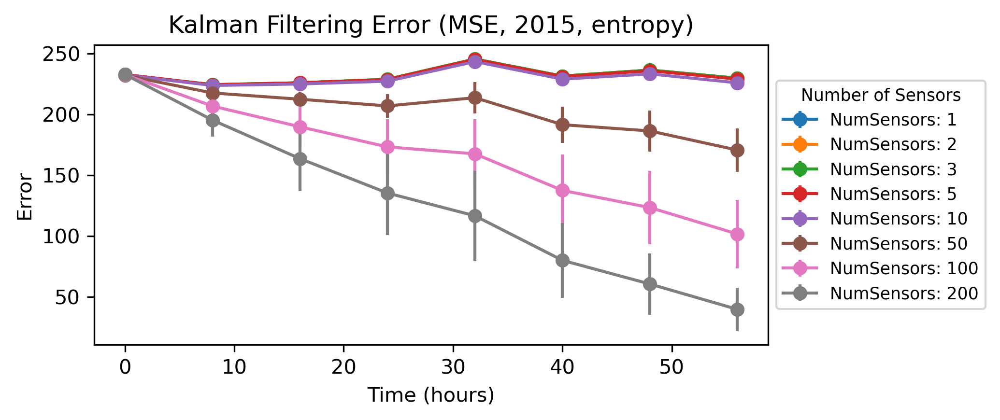

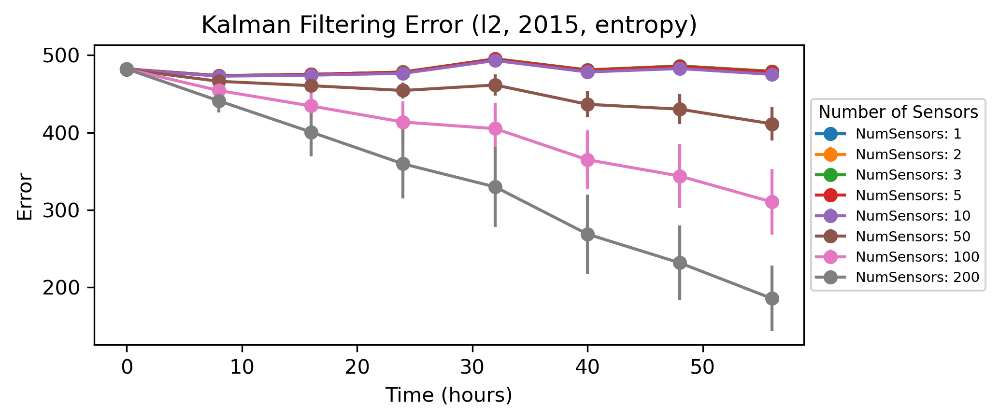

Year: 2018


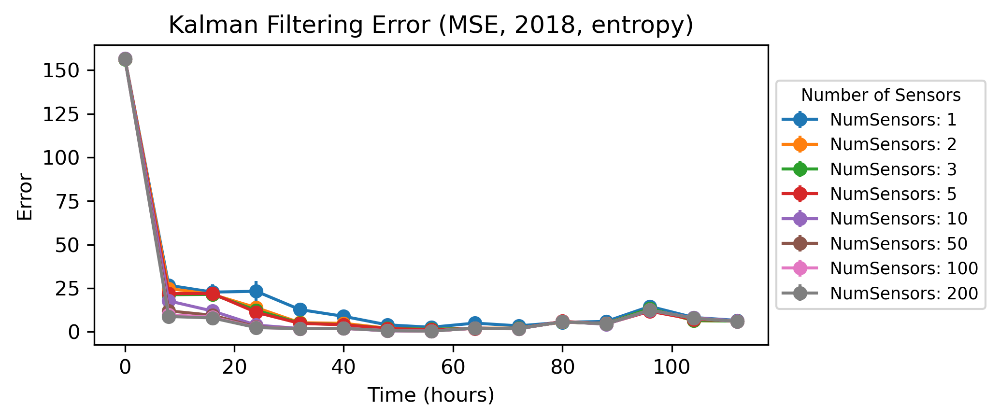

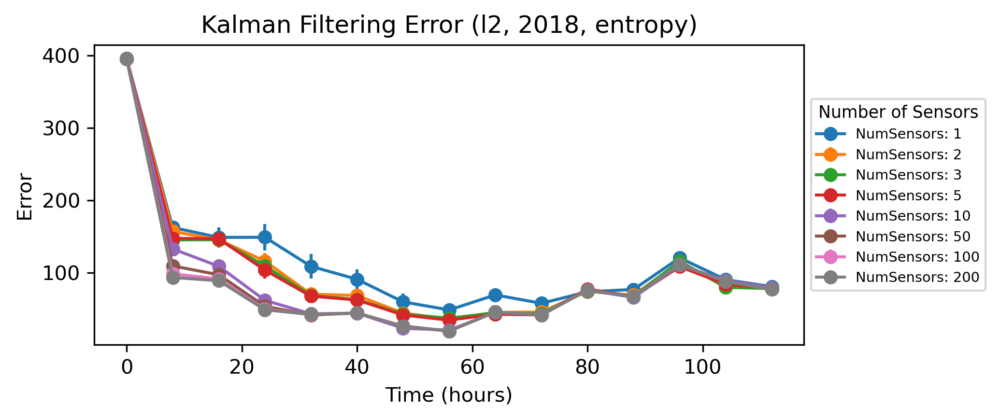

Criteria: avg
Year: 2015


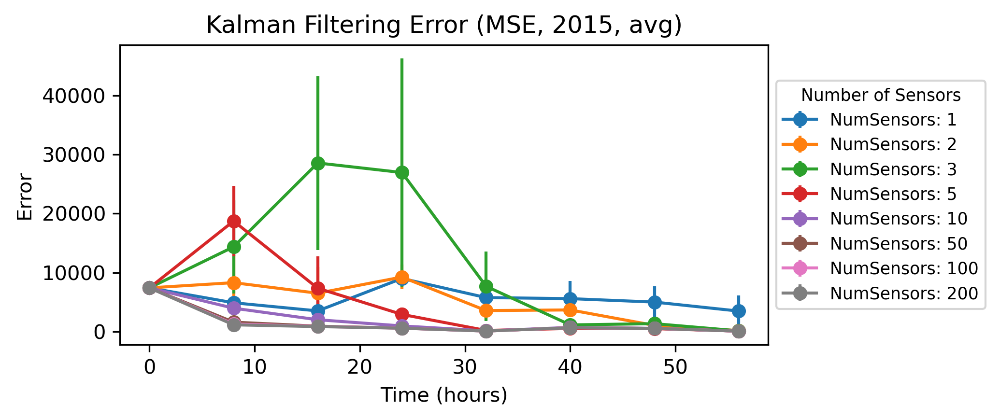

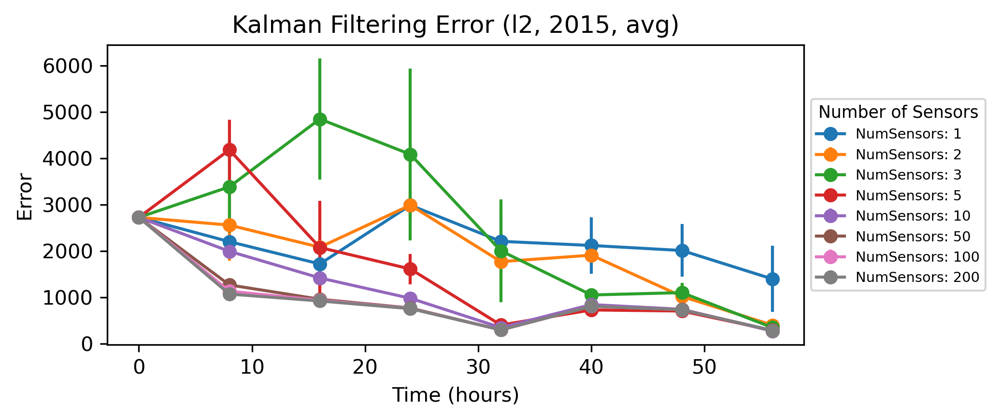

Year: 2018


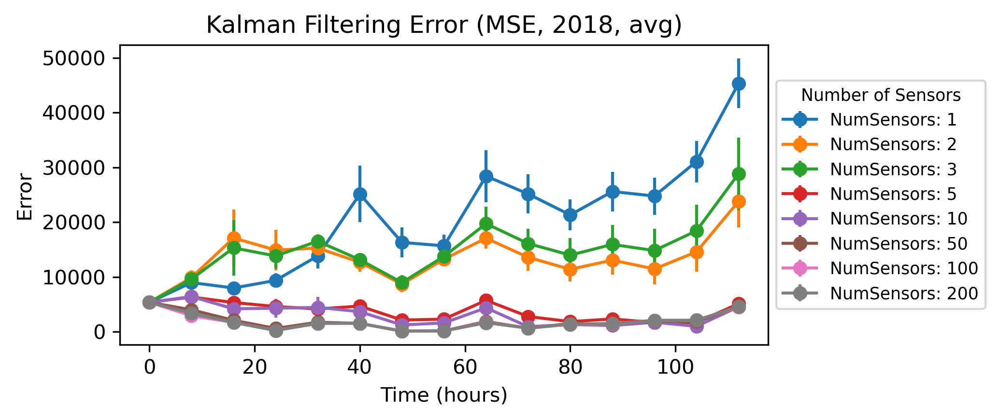

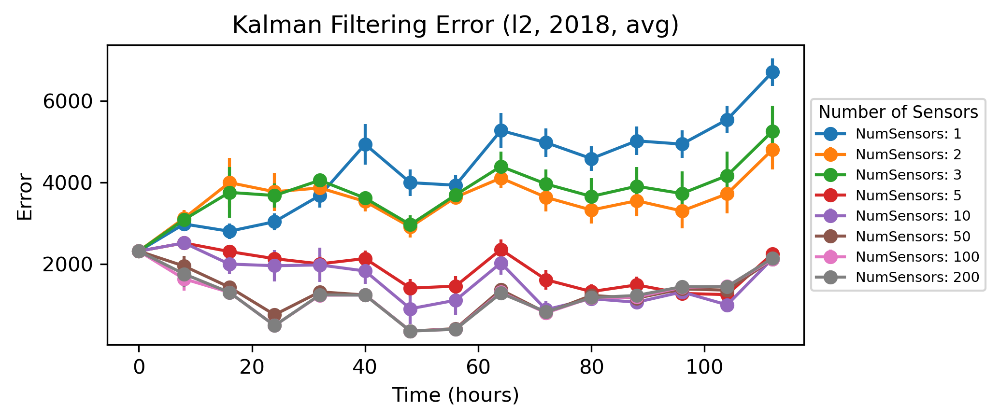

Criteria: std
Year: 2015


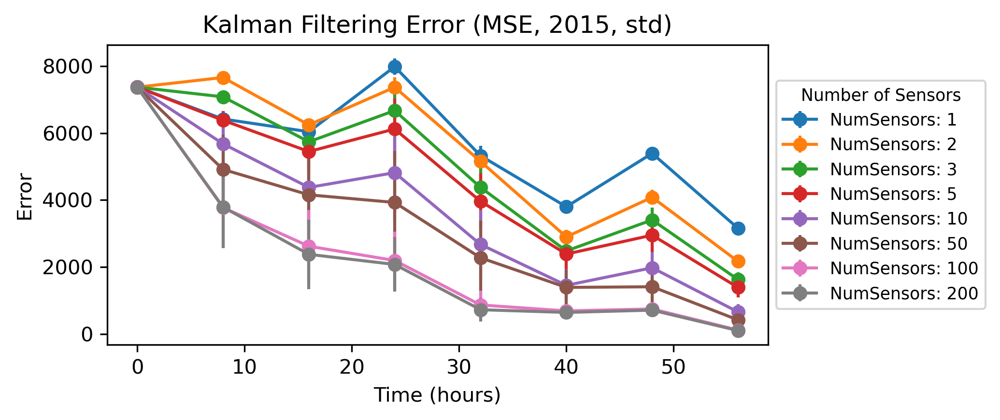

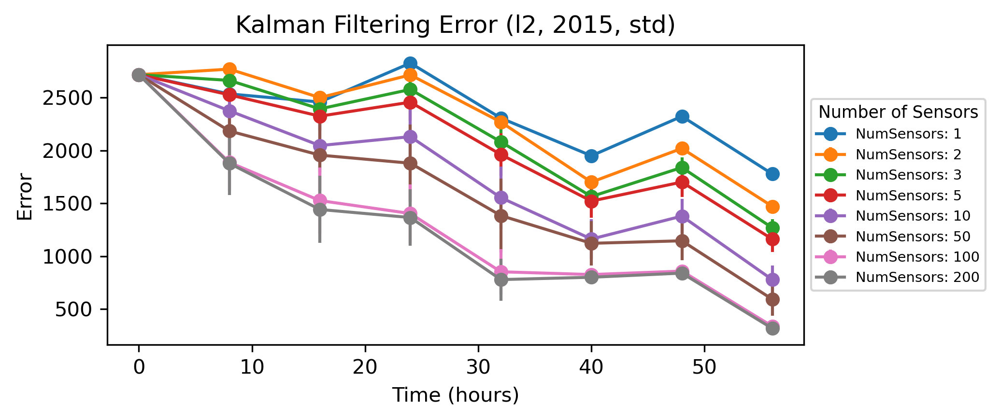

Year: 2018


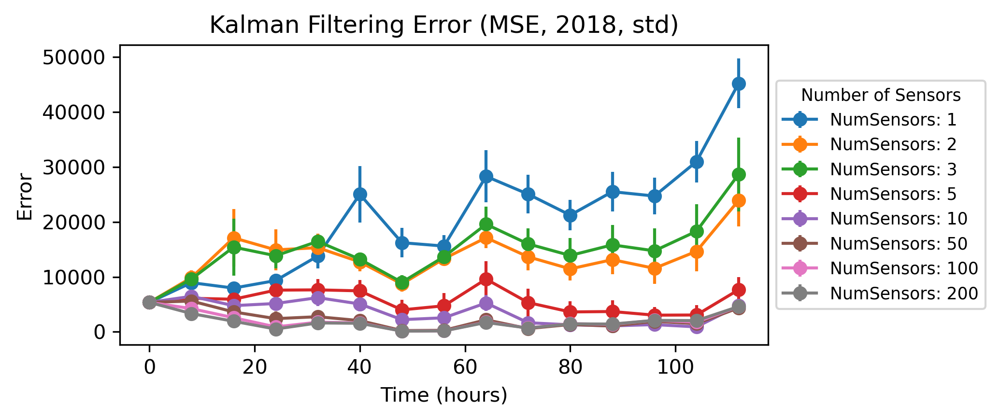

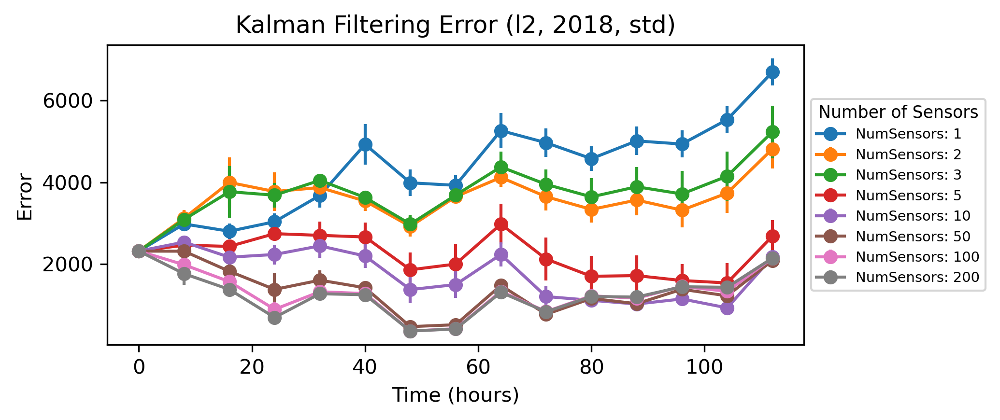

<Figure size 2100x900 with 0 Axes>

In [117]:
trueLine = {'style': '-.',
        'color': 'black',
        'linewidth': 0.5}
predLine = {'style': '-.',
        'color': 'grey',
        'linewidth': 0.25}
sampLine = {'style': '-o',
            'color': 'black',
            'linewidth': 0.5}

for criteria in selectionCriteria:
    print('Criteria: ' + criteria)
    dmd_data_2015, dmd_data_2018, gene_list = filterGeneSet(tpm_2015, tpm_2018,
                                                            k=nGenes,
                                                            criteria=criteria,
                                                            mergeGeneSets=False)
    trajectories = {'2015': dmd_data_2015,
                    '2018': dmd_data_2018}
    for year in ['2015', '2018']:
        print('Year: ' + year)
        estimatorSet = ds[criteria + '_' + year]['estimatorSet']
        trajectory = trajectories[year]
        # print('traj.shape: ' + str(trajectory.shape))
        
        keys = list(estimatorSet.keys())
        keys.sort()

        ## MSE plot
        for numSensors in keys:
            MSE = []
            trajs = estimatorSet[numSensors]
            for t in range(trajectory.shape[1]):
                mse = []
                for i in range(nsims):
                    trajectoriesHat = trajs[i]
                    mse.append((np.square(trajectory[:,t,0] - trajectoriesHat[:,t])).mean())
                MSE.append(mse)
            MSE = np.array(MSE)
            mse_mean_values = np.mean(MSE, axis=1)
            mse_std_errors = np.std(MSE, axis=1) / np.sqrt(MSE.shape[1])
            xrange = 8 * np.array(range(mse_mean_values.shape[0]))
            plt.errorbar(xrange, mse_mean_values, yerr=mse_std_errors, fmt='-o', label='NumSensors: ' + str(numSensors))
        plt.xlabel('Time (hours)')
        plt.ylabel('Error')
        plt.title('Kalman Filtering Error (MSE, ' + year + ', ' + criteria + ')')
        legend = plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), fontsize='small')
        legend.set_title('Number of Sensors', prop={'size': 'small'})
        plt.tight_layout()
        plt.show()
        figName = 'KF_' + year + '_' + criteria + '_MSE_GramSelection_mergeGeneSets_False.png'
        plt.savefig(outPath + figName)
        plt.savefig(curPath + '/figures/' + figName)

        for numSensors in keys:
            L2 = []
            trajs = estimatorSet[numSensors]
            for t in range(trajectory.shape[1]):
                l2 = []
                for i in range(nsims):
                    trajectoriesHat = trajs[i]
                    l2.append(np.linalg.norm(trajectory[:,t,0] - trajectoriesHat[:,t]))
                L2.append(l2)
            L2 = np.array(L2)
            l2_mean_values = np.mean(L2, axis=1)
            l2_std_errors = np.std(L2, axis=1) / np.sqrt(L2.shape[1])
            xrange = 8 * np.array(range(mse_mean_values.shape[0]))
            plt.errorbar(xrange, l2_mean_values, yerr=l2_std_errors, fmt='-o', label='NumSensors: ' + str(numSensors))
        plt.xlabel('Time (hours)')
        plt.ylabel('Error')
        plt.title('Kalman Filtering Error (l2, ' + year + ', ' + criteria + ')')
        legend = plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), fontsize='x-small')
        legend.set_title('Number of Sensors', prop={'size': 'small'})
        plt.tight_layout()
        plt.show()
        figName = 'KF_' + year + '_' + criteria + '_L2_GramSelection_mergeGeneSets_False.png'
        plt.savefig(outPath + figName)
        plt.savefig(curPath + '/figures/' + figName)

## Kalman Filtering 2015 and 2018 data sets (same gene set)

In [102]:
selectionCriteria = ['entropy', 'avg', 'std']
nSensors = [1, 2, 3, 5, 10, 50, 100, 200]
nGenes = 1000
gramT = 50
nsims = 3
ds = {}

In [ ]:
for criteria in selectionCriteria:
    print('Criteria: ' + criteria)
    dmd_data_2015, dmd_data_2018, gene_list = filterGeneSet(tpm_2015, tpm_2018, k=nGenes, criteria=criteria)
    trajectories = {'2015': dmd_data_2015,
                    '2018': dmd_data_2018}
    ss2015 = sensorSelection.hasnain2023(dmd_data_2015, dmd_rank=7, gramT=gramT, vxNames=gene_list)
    ss2018 = sensorSelection.hasnain2023(dmd_data_2018, dmd_rank=7, gramT=gramT, vxNames=gene_list)
    ds[criteria + '_2015'] = {
                                'ss': ss2015
                             }
    ds[criteria + '_2018'] = {
                                'ss': ss2018
                             }
    for year in ['2015', '2018']:
        trajectory = trajectories[year]
        print('Dataset: ' + year)
        print('    trajectory.shape: ' + str(trajectory.shape))
        ss = ds[criteria + '_' + year]['ss']
        estimatorSet = {}
        for numSensors in nSensors: #[3, 5, 7, 10, 12, 15, 17]:
            print('    Num. Sensors:' + str(numSensors))
            A = ss['dmd']['A']
            sensors = ss['sensors']
            sensorGenes = sensors['gene'].values[:numSensors]
            idxs = [list(gene_list).index(gene) for gene in sensorGenes]
            C = getC(A.shape[0], idxs)

            trajectoryUnfolded = trajectory.reshape([trajectory.shape[0], trajectory.shape[1]*2])
            Q = 1 * np.cov(trajectoryUnfolded)

            # construct Kalman filter
            f = KalmanFilter (dim_x=A.shape[0], dim_z=C.shape[0])
            f.F = A
            f.H = C
            f.Q = Q

            trajs = []
            for i in range(nsims):
                print(str(i), end=', ')
                f.x = 1 * np.random.rand(A.shape[0])
                Xhat = [f.x]
                for i in range(trajectory.shape[1]-1):
                    f.predict()
                    f.update(C @ trajectory[:,i,0])
                    Xhat.append(f.x)
                trajectoriesHat = np.array(Xhat).T
                trajs.append(trajectoriesHat)
            print('')

            estimatorSet[numSensors] = trajs
        ds[criteria + '_' + year]['estimatorSet'] = estimatorSet

In [103]:
for criteria in selectionCriteria:
    print('Criteria: ' + criteria)
    dmd_data_2015, dmd_data_2018, gene_list = filterGeneSet(tpm_2015, tpm_2018, k=nGenes, criteria=criteria)
    trajectories = {'2015': dmd_data_2015,
                    '2018': dmd_data_2018}
    ss2015 = sensorSelection.hasnain2023(dmd_data_2015, dmd_rank=7, gramT=gramT, vxNames=gene_list)
    ss2018 = sensorSelection.hasnain2023(dmd_data_2018, dmd_rank=7, gramT=gramT, vxNames=gene_list)
    ds[criteria + '_2015'] = {
                                'ss': ss2015
                             }
    ds[criteria + '_2018'] = {
                                'ss': ss2018
                             }
    for year in ['2015', '2018']:
        trajectory = trajectories[year]
        print('Dataset: ' + year)
        print('    trajectory.shape: ' + str(trajectory.shape))
        ss = ds[criteria + '_' + year]['ss']
        estimatorSet = {}
        for numSensors in nSensors: #[3, 5, 7, 10, 12, 15, 17]:
            print('    Num. Sensors:' + str(numSensors))
            A = ss['dmd']['A']
            sensors = ss['sensors']
            sensorGenes = sensors['gene'].values[:numSensors]
            idxs = [list(gene_list).index(gene) for gene in sensorGenes]
            C = getC(A.shape[0], idxs)

            trajectoryUnfolded = trajectory.reshape([trajectory.shape[0], trajectory.shape[1]*2])
            Q = 1 * np.cov(trajectoryUnfolded)

            # construct Kalman filter
            f = KalmanFilter (dim_x=A.shape[0], dim_z=C.shape[0])
            f.F = A
            f.H = C
            f.Q = Q

            trajs = []
            for i in range(nsims):
                print(str(i), end=', ')
                f.x = 1 * np.random.rand(A.shape[0])
                Xhat = [f.x]
                for i in range(trajectory.shape[1]-1):
                    f.predict()
                    f.update(C @ trajectory[:,i,0])
                    Xhat.append(f.x)
                trajectoriesHat = np.array(Xhat).T
                trajs.append(trajectoriesHat)
            print('')

            estimatorSet[numSensors] = trajs
        ds[criteria + '_' + year]['estimatorSet'] = estimatorSet

Criteria: entropy


/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


Dataset: 2015
    trajectory.shape: (1770, 8, 2)
    Num. Sensors:1
0, 1, 2, 
    Num. Sensors:2
0, 1, 2, 
    Num. Sensors:3
0, 1, 2, 
    Num. Sensors:5
0, 1, 2, 
    Num. Sensors:10
0, 1, 2, 
    Num. Sensors:50
0, 1, 2, 
    Num. Sensors:100
0, 1, 2, 
    Num. Sensors:200
0, 1, 2, 
Dataset: 2018
    trajectory.shape: (1770, 15, 2)
    Num. Sensors:1
0, 1, 2, 
    Num. Sensors:2
0, 1, 2, 
    Num. Sensors:3
0, 1, 2, 
    Num. Sensors:5
0, 1, 2, 
    Num. Sensors:10
0, 1, 2, 
    Num. Sensors:50
0, 1, 2, 
    Num. Sensors:100
0, 1, 2, 
    Num. Sensors:200
0, 1, 2, 
Criteria: avg
Dataset: 2015
    trajectory.shape: (1454, 8, 2)
    Num. Sensors:1
0, 1, 2, 
    Num. Sensors:2
0, 1, 2, 
    Num. Sensors:3
0, 1, 2, 
    Num. Sensors:5
0, 1, 2, 
    Num. Sensors:10
0, 1, 2, 
    Num. Sensors:50
0, 1, 2, 
    Num. Sensors:100
0, 1, 2, 
    Num. Sensors:200
0, 1, 2, 
Dataset: 2018
    trajectory.shape: (1454, 15, 2)
    Num. Sensors:1
0, 1, 2, 
    Num. Sensors:2
0, 1, 2, 
    Num. Sensors

Criteria: entropy
Year: 2015


/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/jpic/.local/lib/python3.9/site-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


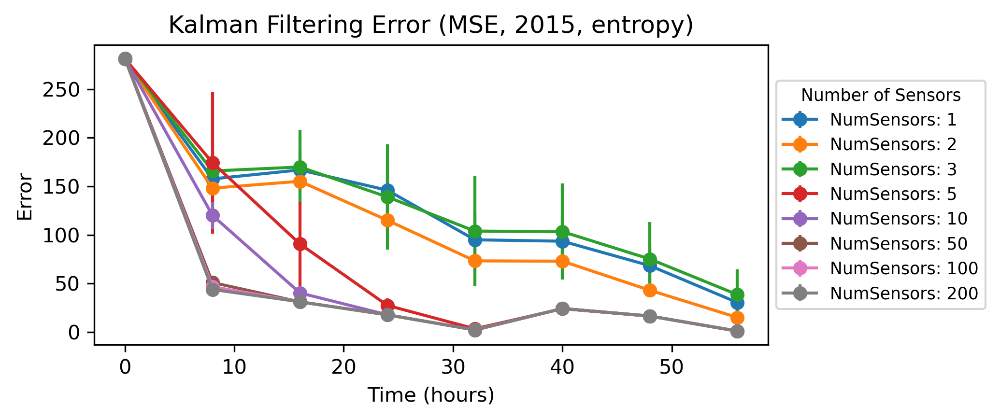

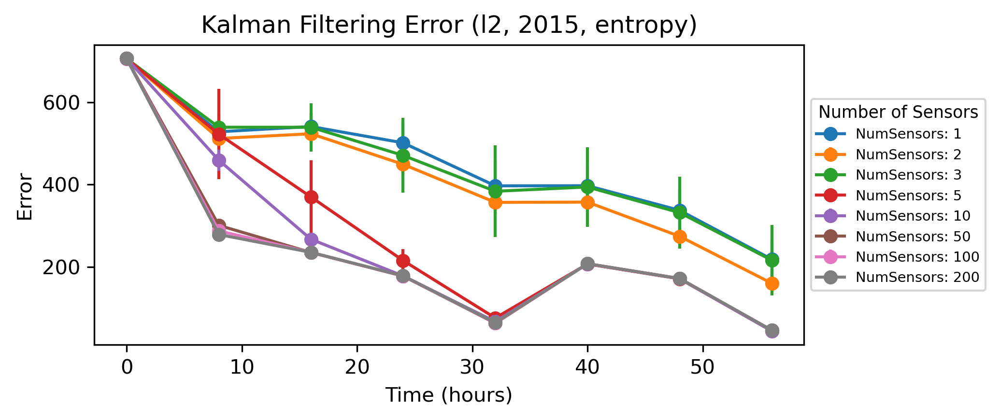

Year: 2018


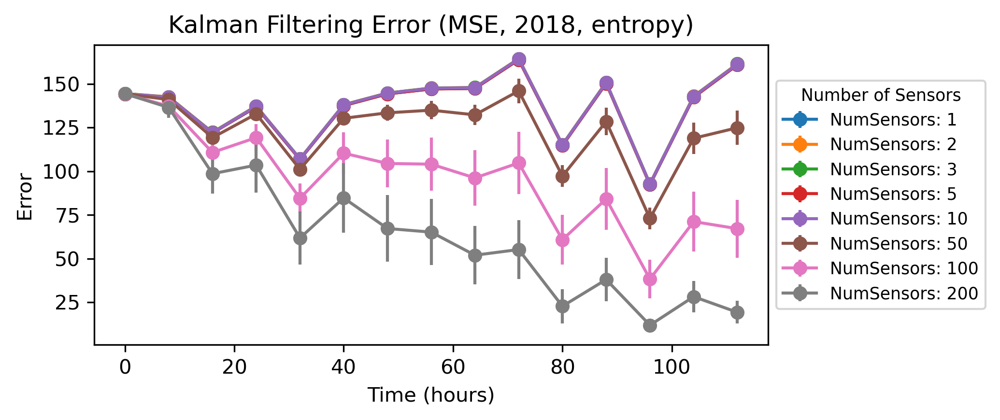

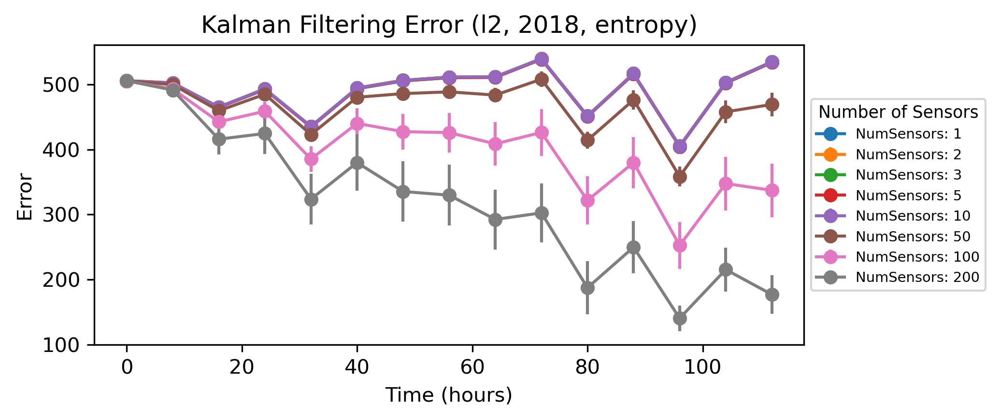

Criteria: avg
Year: 2015


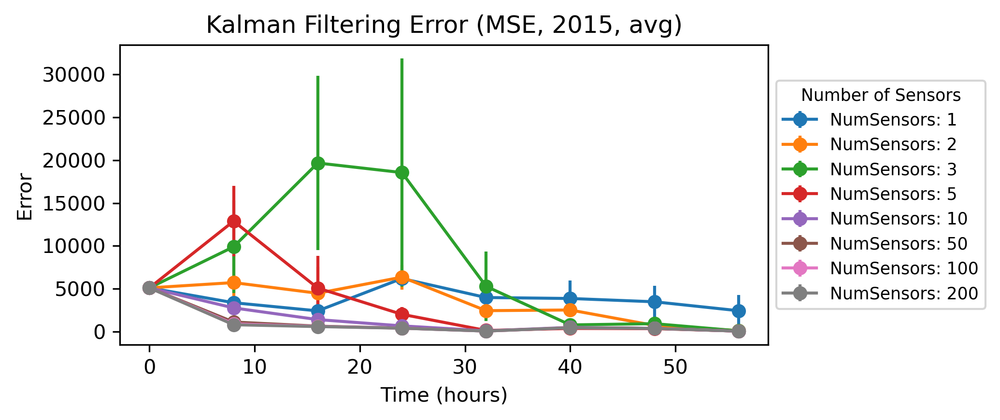

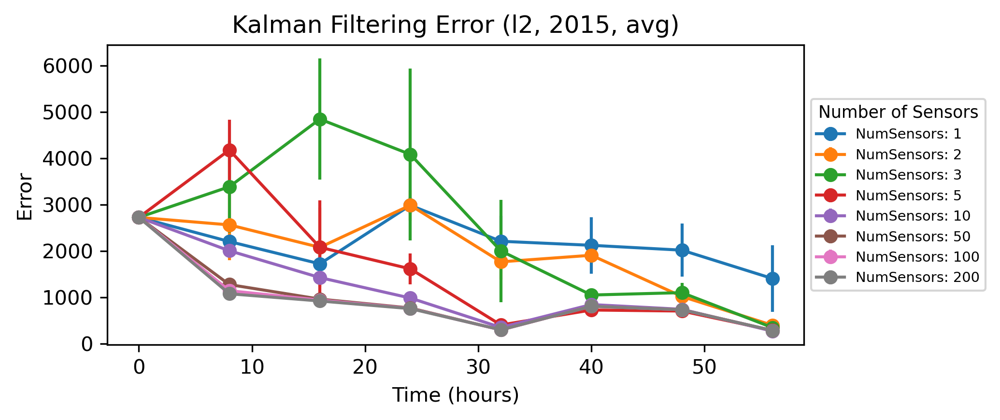

Year: 2018


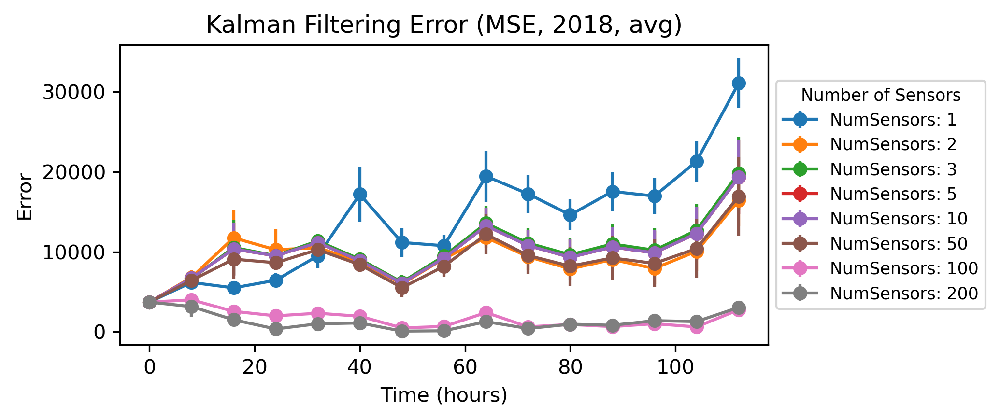

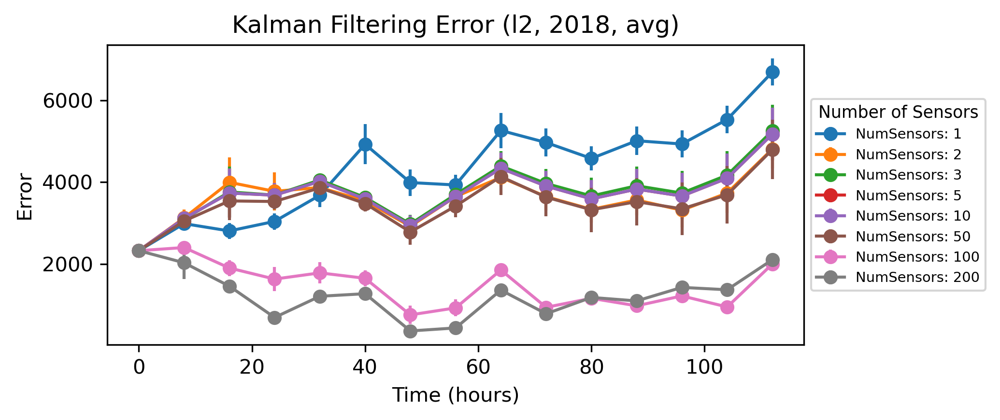

Criteria: std
Year: 2015


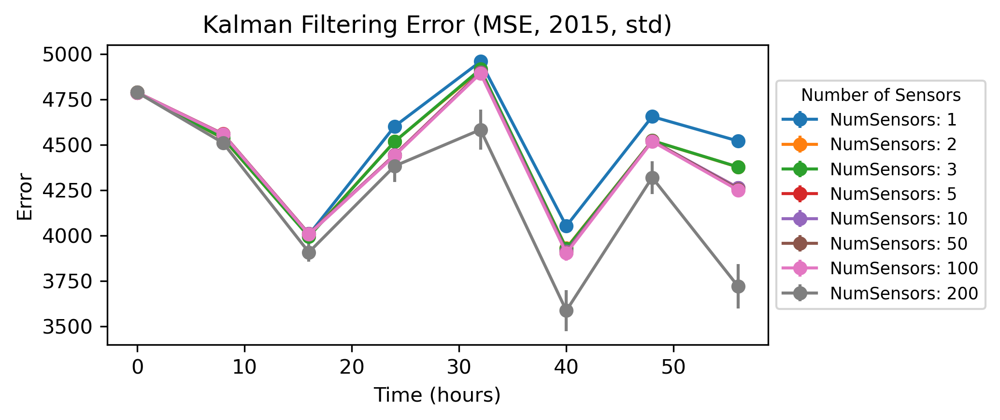

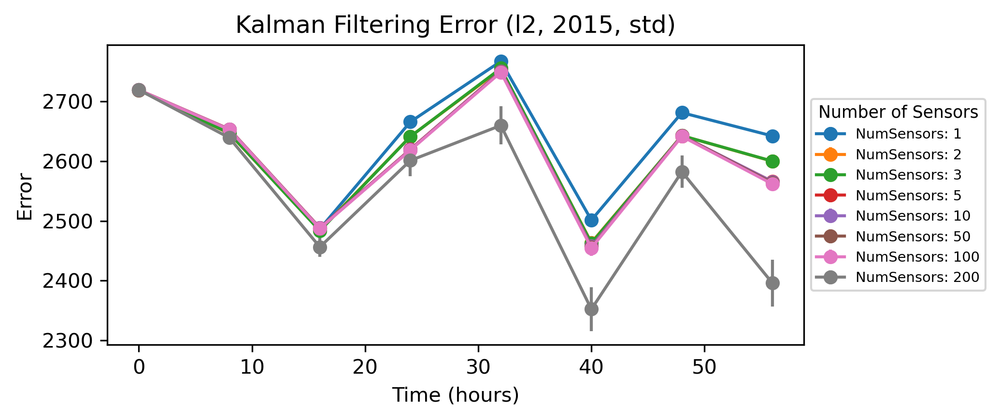

Year: 2018


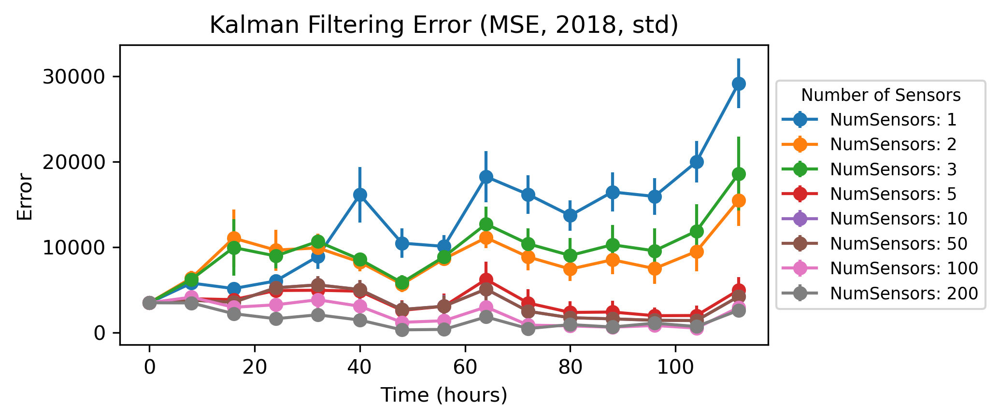

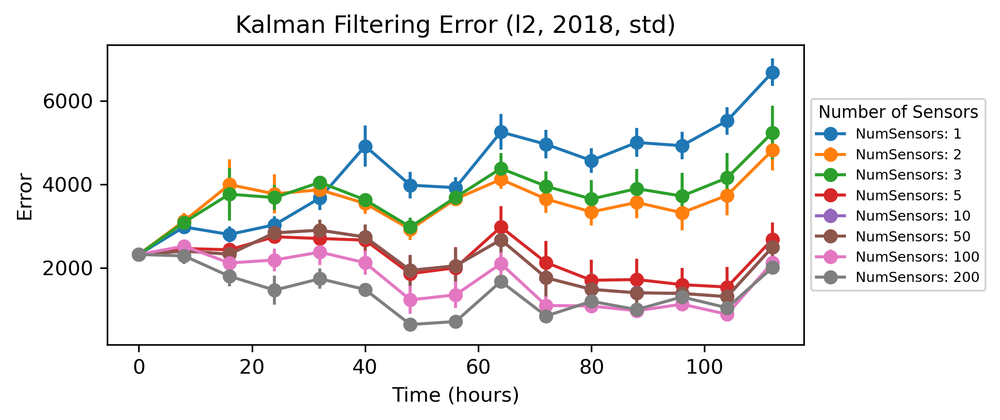

<Figure size 2100x900 with 0 Axes>

In [109]:
trueLine = {'style': '-.',
        'color': 'black',
        'linewidth': 0.5}
predLine = {'style': '-.',
        'color': 'grey',
        'linewidth': 0.25}
sampLine = {'style': '-o',
            'color': 'black',
            'linewidth': 0.5}

for criteria in selectionCriteria:
    print('Criteria: ' + criteria)
    dmd_data_2015, dmd_data_2018, gene_list = filterGeneSet(tpm_2015, tpm_2018, k=nGenes, criteria=criteria)
    trajectories = {'2015': dmd_data_2015,
                    '2018': dmd_data_2018}
    for year in ['2015', '2018']:
        print('Year: ' + year)
        estimatorSet = ds[criteria + '_' + year]['estimatorSet']
        trajectory = trajectories[year]
        # print('traj.shape: ' + str(trajectory.shape))
        
        keys = list(estimatorSet.keys())
        keys.sort()

        ## MSE plot
        for numSensors in keys:
            MSE = []
            trajs = estimatorSet[numSensors]
            for t in range(trajectory.shape[1]):
                mse = []
                for i in range(nsims):
                    trajectoriesHat = trajs[i]
                    # if i == 0 and t == 0:
                        # print('trajHat.shape: ' + str(trajectoriesHat.shape))
                        # print(trajectoriesHat.shape)
                    mse.append((np.square(trajectory[:,t,0] - trajectoriesHat[:,t])).mean())
                MSE.append(mse)
            MSE = np.array(MSE)
            mse_mean_values = np.mean(MSE, axis=1)
            mse_std_errors = np.std(MSE, axis=1) / np.sqrt(MSE.shape[1])
            xrange = 8 * np.array(range(mse_mean_values.shape[0]))
            plt.errorbar(xrange, mse_mean_values, yerr=mse_std_errors, fmt='-o', label='NumSensors: ' + str(numSensors))
        plt.xlabel('Time (hours)')
        plt.ylabel('Error')
        plt.title('Kalman Filtering Error (MSE, ' + year + ', ' + criteria + ')')
        legend = plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), fontsize='small')
        legend.set_title('Number of Sensors', prop={'size': 'small'})
        plt.tight_layout()
        plt.show()
        figName = data + '_MSE_KF_GramSelection_mergeGeneSets_True.png'
        plt.savefig(outPath + figName)
        plt.savefig(curPath + '/figures/' + figName)

        for numSensors in keys:
            L2 = []
            trajs = estimatorSet[numSensors]
            for t in range(trajectory.shape[1]):
                l2 = []
                for i in range(nsims):
                    trajectoriesHat = trajs[i]
                    l2.append(np.linalg.norm(trajectory[:,t,0] - trajectoriesHat[:,t]))
                L2.append(l2)
            L2 = np.array(L2)
            l2_mean_values = np.mean(L2, axis=1)
            l2_std_errors = np.std(L2, axis=1) / np.sqrt(L2.shape[1])
            xrange = 8 * np.array(range(mse_mean_values.shape[0]))
            plt.errorbar(xrange, l2_mean_values, yerr=l2_std_errors, fmt='-o', label='NumSensors: ' + str(numSensors))
        plt.xlabel('Time (hours)')
        plt.ylabel('Error')
        plt.title('Kalman Filtering Error (l2, ' + year + ', ' + criteria + ')')
        legend = plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), fontsize='x-small')
        legend.set_title('Number of Sensors', prop={'size': 'small'})
        plt.tight_layout()
        plt.show()
        figName = data + '_MSE_KF_GramSelection_mergeGeneSets_True.png'
        plt.savefig(outPath + figName)
        plt.savefig(curPath + '/figures/' + figName)

In [66]:
dmd_data_2015.shape

(1544, 8, 2)